In [13]:
from PIL import Image
import h5py
import anubisPlotUtils as anPlot
import json
import numpy as np
import os
import hist as hi
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.colors as colors
matplotlib.use('TkAgg')  # or 'Qt5Agg', 'GTK3Agg', etc.
import mplhep as hep
hep.style.use([hep.style.ATLAS])
import sys
import ANUBIS_triggered_functions as ANT
import pandas as pd
import matplotlib.backends.backend_pdf
from matplotlib.ticker import MultipleLocator
import plotly
import plotly.graph_objs as go
import plotly.express as px

import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import norm

import csv


%matplotlib inline

In [2]:
current_directory=  os.path.dirname(os.getcwd())

data = ANT.importDatafile(current_directory+"\\ProAnubisData\\ATLAS LUMINOSITY\\proAnubis_240403_0227.h5")

KeyboardInterrupt: 

In [ ]:
data_ATLAS = [sublist[:94230] for sublist in data]
etaHits, phiHits = ANT.divideHitCountsByRPC_Timed(data_ATLAS)

In [ ]:
#Time_window for coincidence set at 15 ns.
#Temporal Clustering
coincident_hits_ATLAS = ANT.FindCoincidentHits(etaHits,phiHits,15)

#Spatial Clustering
coincident_hits_ATLAS_clustered = ANT.cluster(coincident_hits_ATLAS)

0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0

In [3]:
def plot_angle_distribution_absolute(angles, title, label, bin_size):
    #Plot angular distribution given phi and eta angular distribution separately.
    #Plot absolute number of counts rather than relative occurence.
    #bin_size in degrees

    plt.figure(figsize=(16,10))

    angles_degrees = [x*(180/np.pi) for x in angles]
    bin_edges = np.arange(-90.5, 91.5, bin_size)

    # Plot histogram with counts
    plt.hist(angles_degrees, bins=bin_edges, density=False,edgecolor='black',alpha=0.7, label=f"{label}")
    
    plt.annotate(f"Number of events = {len(angles)}",(0.2,0.6),xycoords='figure fraction')

    plt.xlim(-90,90)

    # Customize the plot
    plt.xlabel('Angle/ degrees from axis perpendicular to surface of RPCs')
    plt.ylabel('Number of Counts')
    plt.title(title)
    plt.legend()
    plt.show()

In [4]:
def extract_coords_timed_Chi2(event,max_cluster_size):

    #This function converts spatially clusters in RPCs into x and y coordinates (z given by RPC number)
    # event = ['Event x',TIMEBIN, [[[RPC1_PHI_CLUSTERS],[RPC1_ETA_CLUSTERS]],[[...],[...]],...]

    #Extract x and y coords of cluster in event
    distance_per_phi_channel = 2.7625 #cm
    distance_per_eta_channel = 2.9844 #cm
    
    coords = []

    for RPC in range(6):
        
        x_clusters = [x for x in event[2][RPC][0] if len(x)<=max_cluster_size] #phi direction
        y_clusters = [y for y in event[2][RPC][1] if len(y)<=max_cluster_size] #eta direction

        #Finding size of largest cluster, consider coordinates bad if largest cluster is larger than 6.
        x_clusters_lengths = [len(x) for x in event[2][RPC][0]]
        y_clusters_lengths = [len(y) for y in event[2][RPC][1]]

        max_length = max(max(x_clusters_lengths, default=0), max(y_clusters_lengths, default=0))

        x_coords = []
        y_coords = []
        x_times =  []

        for x_cluster in x_clusters:
           #x_cluster = [[RPC,CHANNEL,TIME,'phi'],...]
            phi_channels = [x[1] for x in x_cluster]
            phi_times = [t[2] for t in x_cluster]

            #Convert the channel number into a measurement along the RPC.
            x_values = [(phi_channel+0.5)*distance_per_phi_channel for phi_channel in phi_channels]

            #Variance in x coord.
            x_var = (1*distance_per_phi_channel)**2/12

            x_coords.append([np.mean(x_values),x_var,np.average(phi_times)])

        for y_cluster in y_clusters:
            #y_cluster = [[RPC,CHANNEL,TIME,'eta'],...]
            eta_channels_corrected = [31-y[1] for y in y_cluster] #corrected for labelling from 0 to 31.
            y_values = [(channel_num+0.5)*distance_per_eta_channel for channel_num in eta_channels_corrected]
            
            y_var = (1*distance_per_eta_channel)**2 /12
            y_coords.append([np.mean(y_values),y_var])

        if x_coords and y_coords and max_length<6:

            coords.append([x_coords, y_coords,x_times])

        else:
            coords.append([[],[],"N"])

    #[x_coords] = [[x,err_x,x_time],...]
    
    #RPC_coords = [x_coords,y_coords,x_times]

    #coords = [[RPC1_coords],[RPC2_coords],[RPC3_coords],...]
    return coords

def extract_DT_DZ_Chi2(coords):

    #coords = [[[x0,var,time],[y0,var],z0],[[x1,var,time],[y1,var],z1],...,[[x5,var,time],[y5,var],z5]]

    times = [[RPC,x[0][2]] for RPC, x in enumerate(coords) if isinstance(x[2], (float, int))]

    #Should already be sorted, but just in case.
    #Sort times by RPC, with RPC at lowest height at first entry.

    if len(times) > 1:

        times_sorted = sorted(times, key=lambda x: x[0])

        #print(times_sorted)

        dT = times_sorted[-1][1]-times_sorted[0][1]
        #if dT>0 this implies the particles hit the higher RPC after the lower one, so the particle is travelling upwards here.
        #Vice-versa for dT < 0 

        RPC_heights = [0.6,1.8,3.0,61.8,121.8,123] #Heights of middle point of each RPC, measured from the bottom of the Triplet Low RPC. Units are cm.

        first_RPC = times_sorted[0][0]
        last_RPC = times_sorted[-1][0]

        dZ = RPC_heights[last_RPC] - RPC_heights[first_RPC]
    
        return dT, dZ
    else:
        pass

def fit_event_chi2(coordinates_with_error):
    #Coordinates = [[[x0,var,time],[y0,var],z0],[[x1,var,time],[y1,var],z1],...,[[x5,var,time],[y5,var],z5]]
    #Z coordinate given by height of relevant RPC.
    #Using SVD

    # Calculate dT for event, in ns
    dT, dZ = extract_DT_DZ_Chi2(coordinates_with_error)
    
    coordinates = []

    for coords in coordinates_with_error:
        coordinates.append([coords[0][0],coords[1][0],coords[2]])

    centroid = np.mean(coordinates, axis=0)
    subtracted = coordinates-centroid

    # performing SVD
    _, _, V = np.linalg.svd(subtracted)
    
    # find the direction vector (which is the right singular vector corresponding to the largest singular value)
    direction = V[0, :]

    # A line is defined by the average and its direction
    p0 = centroid
    d = direction

    #Work out Chi2. Minimise this to find best fit (from possible combos)

    Chi2 = 0

    i = 0 

    for point in coordinates_with_error:
        
        i+=2
        
        z = point[2]
        x = point[0][0]
        y = point[1][0]
        x_var = point[0][1]
        y_var = point[1][1]

        z_0 = centroid[2]

        # t = (z-z_0)/d_z

        t = (z-z_0)/d[2]

        # Find expected (x,y) coordinates at that height.

        x_traj = centroid[0] + t*d[0]
        y_traj = centroid[1] + t*d[1]

        Chi2_x = (x-x_traj)**2 / x_var
        Chi2_y = (y-y_traj)**2 / y_var

        Chi2+= Chi2_x
        Chi2+= Chi2_y

    # i is number of fitted points. There are 4 fitted paramters, 2 for each x and y. 
    doF = i - 4

    Chi2 = Chi2/ doF

    return p0, d, Chi2, coordinates, dT, dZ

def generate_hit_coords_combo_Chi2(coords, RPC_heights, combinations=None, hit_coords=None, depth=0):

    if combinations is None:
        combinations = []
    if hit_coords is None:
        hit_coords = []

    if depth == len(coords):
        combinations.append(hit_coords.copy())
        return combinations

    x_values = coords[depth][0]
    y_values = coords[depth][1]

    if not x_values or not y_values:
        return generate_hit_coords_combo_Chi2(coords, RPC_heights, combinations, hit_coords, depth + 1)

    for x in x_values:
        for y in y_values:
            if x is not None and y is not None and isinstance(x[0], (int, float)) and isinstance(y[0], (int, float)):
                hit_coords.append([x, y, RPC_heights[depth]])
                generate_hit_coords_combo_Chi2(coords, RPC_heights, combinations, hit_coords, depth + 1)
                hit_coords.pop()

    return combinations

def reconstruct_timed_Chi2(event,max_cluster_size):

    #timed tag indicates that timing information from RPC is used to determine direction of vertical transversal of "particle" in the event.

    max_Chi2 = 10

    # event = ['Event x',TIMEBIN, [[[RPC1_PHI_CLUSTERS],[RPC1_ETA_CLUSTERS]],[[...],[...]],...]
    RPC_heights = [0.6,1.8,3.0,61.8,121.8,123] #Heights of middle point of each RPC, measured from the bottom of the Triplet Low RPC. Units are cm.

    #Extract x and y coords of cluster in event

    coords = ANT.extract_coords_timed_Chi2(event,max_cluster_size)

    # Count the number of empty RPCs
    empty_RPC_count = sum(1 for item in coords if item == [[], [],'N'])

    # If less than 3 elements of coords are occupied, exit the function
    if empty_RPC_count > 3:
        #print("Failed to reconstruct, not enough coords")
        return None  # Exit the function
    
    #NEED TO CHECK IF STILL CROSS CHAMBER! 

    cross_chamberness = 0

    if coords[0] != [[], [], 'N'] or coords[1] != [[], [], 'N'] or coords[2] != [[], [], 'N']:
        cross_chamberness += 1

    if coords[3] != [[], [], 'N']:
        cross_chamberness += 1

    if coords[4] != [[], [], 'N'] or coords[5] != [[], [], 'N']:
        cross_chamberness += 1

    # print(coords[0])
    # print(coords[1])
    # print(coords[2])
    # print(coords[3])
    # print(coords[4])
    # print(coords[5])
    # print(cross_chamberness)

    if cross_chamberness < 2:
        #print("Failed to reconstruct, too few chambers")
        return None

    #ITERATING OVER EVERY POSSIBLE COMBINATION OF x,y,z over all 3 RPCs (limited to one x,y per RPC).
    #Doesn't look particularly nice, but there are not many coordinates to loop over usually....

    combinations = ANT.generate_hit_coords_combo_Chi2(coords,RPC_heights)

    #Now for each combo in combinations, attempt to reconstruct a path. See which one gives the best trajectory.

    #If success, print parameters of fitting function.
    #If fail, print reconstruction failed.

    Chi2_current = np.inf
    optimised_coords = None
    optimised_d= None
    optimised_centroid= None
    dT = np.inf

    for ind,combo in enumerate(combinations):

        centroid, d, Chi2, coordinates, delta_T, delta_Z= fit_event_chi2(combo)
        if Chi2 < Chi2_current:

            # If new fit is better than old then replace old fit properties.
            dZ = delta_Z 
            dT = delta_T
            Chi2_current = Chi2
            optimised_centroid = centroid
            optimised_d = d
            optimised_coords = coordinates

    #if dT>0 this implies the particles hit the higher RPC after the lower one, so the particle is travelling upwards here.
    #Vice-versa for dT < 0.

    #dT = 0 case?
    
    if dT != np.inf:

        if dT > 0:
            if optimised_d[2] < 0:
                optimised_d = np.multiply(optimised_d,-1)
        else:
            if optimised_d[2] > 0:
                optimised_d = np.multiply(optimised_d,-1)

        if Chi2_current<max_Chi2:
            return optimised_centroid, optimised_d, optimised_coords, combinations, Chi2_current, dT, dZ

        else:
            #print("Failed to reconstruct, Chi2 too large")
            #return optimised_centroid, optimised_d, optimised_coords, combinations, residuals_current
            return None

In [5]:
def extract_angles_phi_eta_timed_DZ(filtered_events):

    #Input is filtered_events, output of ANT.filter_events() function

    angles_eta = []
    angles_phi = []
    delta_times = []
    dZ = []
    chi2_values = []

    for i,filtered_event in enumerate(filtered_events):

        print(f"Index= {i}") 
        
        result = reconstruct_timed_Chi2(filtered_event,3)

        if result is not None:

            delta_times.append(result[5])

            chi2_values.append(result[4])

            if abs(result[5])>40:
                print(f"Index of abnormal event= {i}")
            #Only save angles that actually were reconstructed well

            dZ.append(result[6])
            
            # a.b = |a||b|cos(x)

            #eta angle. 
            #work out the projection of the direction vector in the plane.
            
            v_parr_eta = np.array([0,result[1][1],result[1][2]])

            theta_eta = np.arccos(np.dot(v_parr_eta,[0,0,1]) / np.linalg.norm(v_parr_eta))

            if theta_eta > np.pi / 2:
                theta_eta= np.pi - theta_eta
            
            if v_parr_eta[1] > 0:
                theta_eta*=-1

            angles_eta.append(theta_eta)

            # Phi angles
            #work out the projection of the direction vector in the plane.
            
            v_parr_phi = np.array([result[1][0],0,result[1][2]])

            theta_phi = np.arccos(np.dot(v_parr_phi,[0,0,1]) / np.linalg.norm(v_parr_phi))

            if theta_phi > np.pi / 2:
                theta_phi= np.pi - theta_phi
            
            if v_parr_phi[0] < 0:
                theta_phi*=-1

            angles_phi.append(theta_phi)

    return angles_eta, angles_phi, delta_times, dZ, chi2_values

In [30]:
#Filter events depending on what you would like to look at.
#filter_events(data,minimum number of chambers hit, minimum number of RPCs hit)
cross_chamber_3_rpc_events = ANT.filter_events(coincident_hits_ATLAS_clustered,2,3)
print("......")
all_6_rpcs = ANT.filter_events(coincident_hits_ATLAS_clustered,3,6)

Number of events in filter = 27227
......
Number of events in filter = 1334


In [31]:
angles_eta, angles_phi, times_delta, z_delta, chi2_values = extract_angles_phi_eta_timed_DZ(cross_chamber_3_rpc_events)

Index= 0
[[], [], 'N']
[[[120.16875, 0.6359505208333335, 238.0]], [[79.0866, 0.7422202800000001]], []]
[[], [], 'N']
[[[129.8375, 0.6359505208333335, 234.5], [149.175, 0.6359505208333335, 239.5]], [[82.071, 0.7422202800000001]], []]
[[], [], 'N']
[[[136.74375, 0.6359505208333335, 229.0]], [[68.6412, 0.7422202800000001]], []]
3
Index= 1
[[[62.15625000000001, 0.6359505208333335, 235.0]], [[70.1334, 0.7422202800000001]], []]
[[[62.15625000000001, 0.6359505208333335, 234.0]], [[70.1334, 0.7422202800000001]], []]
[[[62.15625000000001, 0.6359505208333335, 233.0]], [[70.1334, 0.7422202800000001]], []]
[[[96.6875, 0.6359505208333335, 232.5]], [[43.2738, 0.7422202800000001]], []]
[[], [], 'N']
[[], [], 'N']
2
Index= 2
[[[136.74375, 0.6359505208333335, 242.0]], [[76.1022, 0.7422202800000001]], []]
[[[136.74375, 0.6359505208333335, 240.0]], [[76.1022, 0.7422202800000001]], []]
[[[136.74375, 0.6359505208333335, 238.0]], [[77.59440000000001, 0.7422202800000001]], []]
[[[147.79375000000002, 0.635950

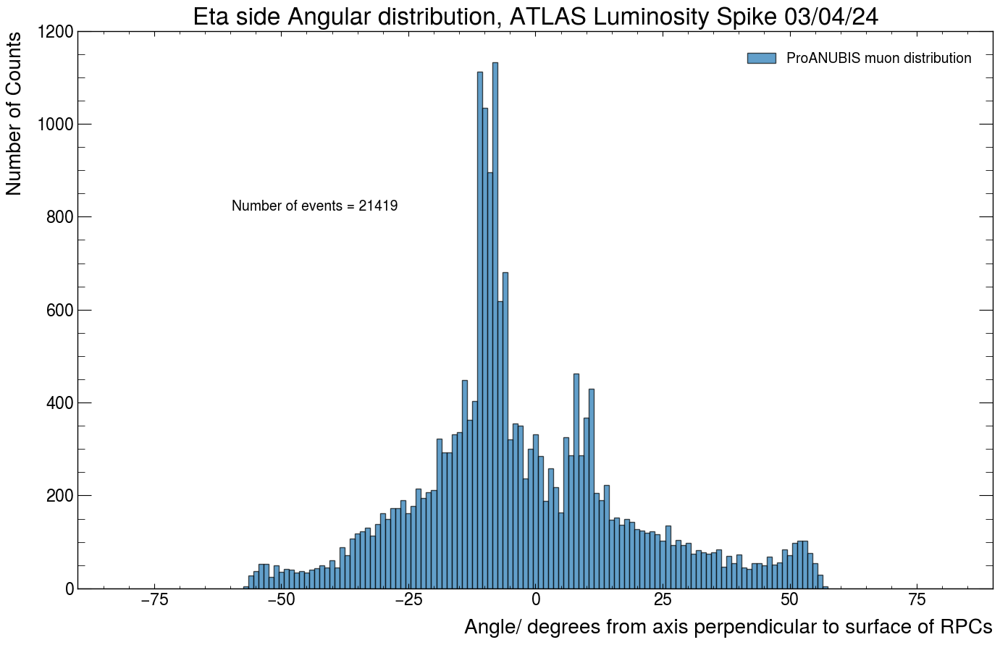

In [32]:
plot_angle_distribution_absolute(angles_eta,"Eta side Angular distribution, ATLAS Luminosity Spike 03/04/24","ProANUBIS muon distribution")

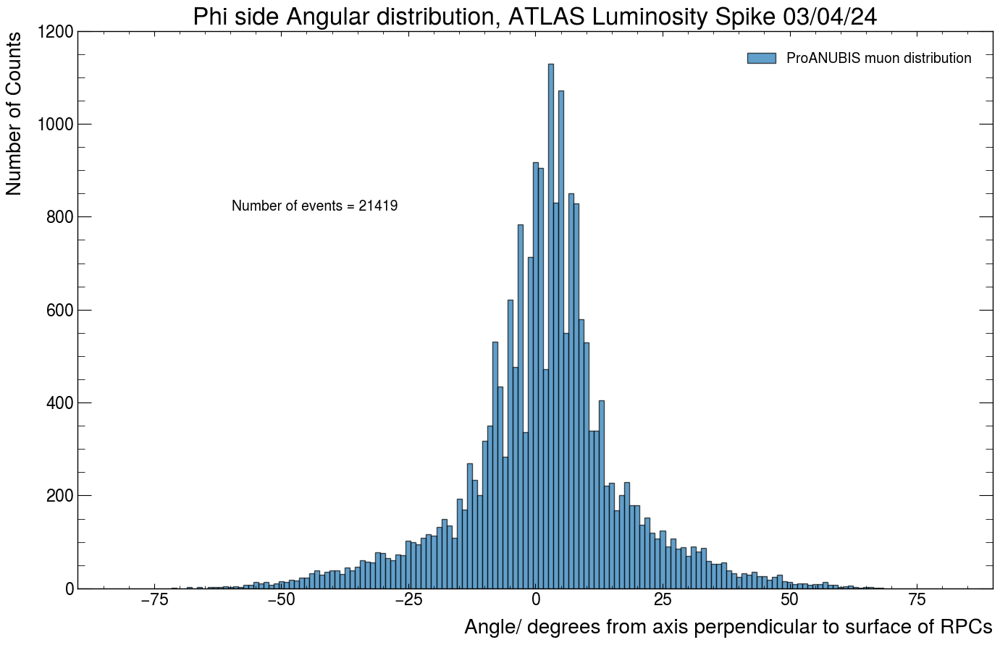

In [33]:
plot_angle_distribution_absolute(angles_phi,"Phi side Angular distribution, ATLAS Luminosity Spike 03/04/24","ProANUBIS muon distribution")

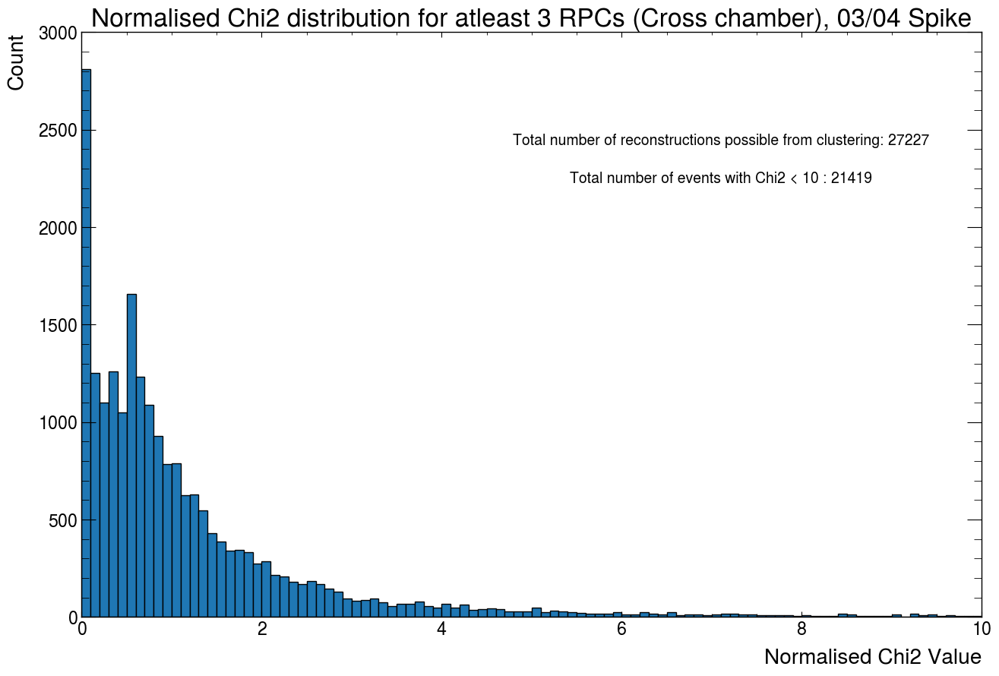

In [114]:
Chi2_values_filtered = [x for x in chi2_values if x <= 10]

plt.figure(figsize=(15,10))

bin_edges = np.arange(-0.5, 11.5, 0.1)

plt.hist(Chi2_values_filtered,density=False,edgecolor='black',bins=bin_edges)

#plt.xlim(0,100)
#plt.yscale('log')

plt.xlabel('Normalised Chi2 Value')
plt.ylabel('Count')

plt.xlim(0,10)

plt.annotate(f"Total number of reconstructions possible from clustering: {len(cross_chamber_3_rpc_events)}",(0.45,0.7),xycoords='figure fraction')
plt.annotate(f"Total number of events with Chi2 < 10 : {len(Chi2_values_filtered)}",(0.5,0.65),xycoords='figure fraction')

plt.title('Normalised Chi2 distribution for atleast 3 RPCs (Cross chamber), 03/04 Spike')

plt.show()

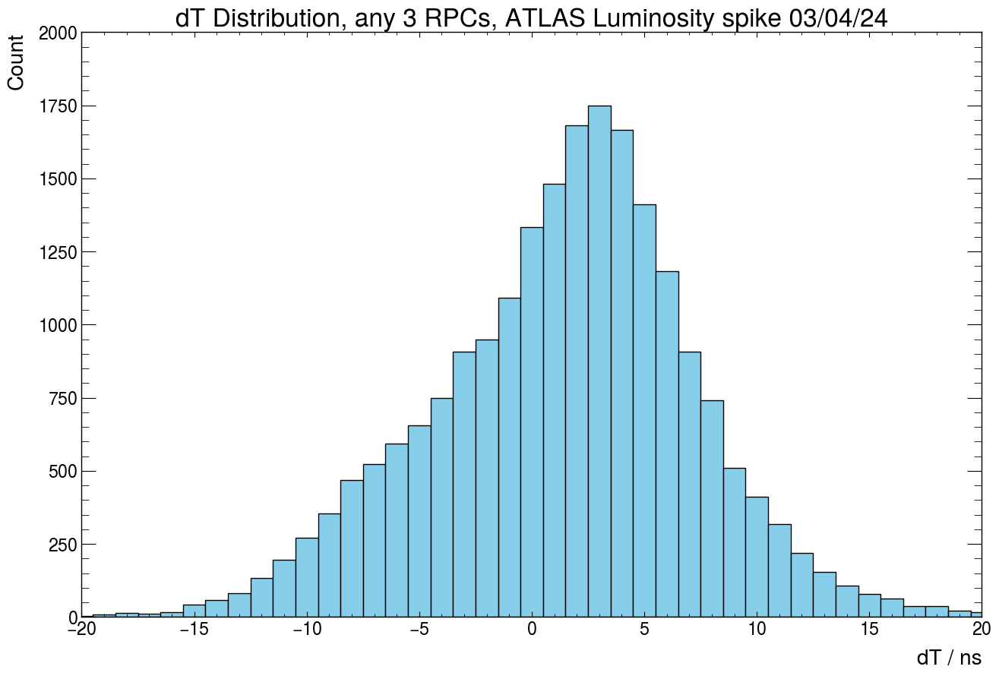

In [34]:
times_delta_filtered = [x for x in times_delta if abs(x) <=20]

# Define bin edges centered on integers between -20 and +20
bin_edges = np.arange(-20.5, 21.5, 1)

plt.figure(figsize=(15,10))

# Plotting histogram
plt.hist(times_delta_filtered, bins=bin_edges, color='skyblue', edgecolor='black')
plt.xlim(-20,20)

# Adding labels and title
plt.xlabel('dT / ns')
plt.ylabel('Count')
plt.title('dT Distribution, any 3 RPCs, ATLAS Luminosity spike 03/04/24')

# Displaying the plot
plt.show()


In [35]:
#Filter events depending on what you would like to look at.
#filter_events(data,minimum number of chambers hit, minimum number of RPCs hit)
three_rpc_events = ANT.filter_events(coincident_hits_ATLAS_clustered,1,3)
print("......")

Number of events in filter = 57690
......


In [38]:
angles_eta2, angles_phi2, times_delta2, z_delta2, chi2_values2 = extract_angles_phi_eta_timed_DZ(three_rpc_events)

Index= 0
Index= 1
Index= 2
Index= 3
Index= 4
Index= 5
Index= 6
Index= 7
Index= 8
Index= 9
Index= 10
Index= 11
Index= 12
Index= 13
Index= 14
Index= 15
Index= 16
Index= 17
Index= 18
Index= 19
Index= 20
Index= 21
Index= 22
Index= 23
Index= 24
Index= 25
Index= 26
Index= 27
Index= 28
Index= 29
Index= 30
Index= 31
Index= 32
Index= 33
Index= 34
Index= 35
Index= 36
Index= 37
Index= 38
Index= 39
Index= 40
Index= 41
Index= 42
Index= 43
Index= 44
Index= 45
Index= 46
Index= 47
Index= 48
Index= 49
Index= 50
Index= 51
Index= 52
Index= 53
Index= 54
Index= 55
Index= 56
Index= 57
Index= 58
Index= 59
Index= 60
Index= 61
Index= 62
Index= 63
Index= 64
Index= 65
Index= 66
Index= 67
Index= 68
Index= 69
Index= 70
Index= 71
Index= 72
Index= 73
Index= 74
Index= 75
Index= 76
Index= 77
Index= 78
Index= 79
Index= 80
Index= 81
Index= 82
Index= 83
Index= 84
Index= 85
Index= 86
Index= 87
Index= 88
Index= 89
Index= 90
Index= 91
Index= 92
Index= 93
Index= 94
Index= 95
Index= 96
Index= 97
Index= 98
Index= 99
Index= 100

C:\Users\patri\AppData\Local\Temp\ipykernel_21464\3290246452.py:138: RuntimeWarning: divide by zero encountered in scalar divide
  t = (z-z_0)/d[2]
C:\Users\patri\AppData\Local\Temp\ipykernel_21464\3290246452.py:143: RuntimeWarning: invalid value encountered in scalar multiply
  y_traj = centroid[1] + t*d[1]
C:\Users\patri\AppData\Local\Temp\ipykernel_21464\3290246452.py:138: RuntimeWarning: invalid value encountered in scalar divide
  t = (z-z_0)/d[2]


Index= 777
Index= 778
Index= 779
Index= 780
Index= 781
Index= 782
Index= 783
Index= 784
Index= 785
Index= 786
Index= 787
Index= 788
Index= 789
Index= 790
Index= 791
Index= 792
Index= 793
Index= 794
Index= 795
Index= 796
Index= 797
Index= 798
Index= 799
Index= 800
Index= 801
Index= 802
Index= 803
Index= 804
Index= 805
Index= 806
Index= 807
Index= 808
Index= 809
Index= 810
Index= 811
Index= 812
Index= 813
Index= 814
Index= 815
Index= 816
Index= 817
Index= 818
Index= 819
Index= 820
Index= 821
Index= 822
Index= 823
Index= 824
Index= 825
Index= 826
Index= 827
Index= 828
Index= 829
Index= 830
Index= 831
Index= 832
Index= 833
Index= 834
Index= 835
Index= 836
Index= 837
Index= 838
Index= 839
Index= 840
Index= 841
Index= 842
Index= 843
Index= 844
Index= 845
Index= 846
Index= 847
Index= 848
Index= 849
Index= 850
Index= 851
Index= 852
Index= 853
Index= 854
Index= 855
Index= 856
Index= 857
Index= 858
Index= 859
Index= 860
Index= 861
Index= 862
Index= 863
Index= 864
Index= 865
Index= 866
Index= 867

C:\Users\patri\AppData\Local\Temp\ipykernel_21464\3290246452.py:142: RuntimeWarning: invalid value encountered in scalar multiply
  x_traj = centroid[0] + t*d[0]


Index= 2721
Index= 2722
Index= 2723
Index= 2724
Index of abnormal event= 2724
Index= 2725
Index= 2726
Index= 2727
Index= 2728
Index= 2729
Index= 2730
Index= 2731
Index= 2732
Index= 2733
Index= 2734
Index= 2735
Index= 2736
Index= 2737
Index= 2738
Index= 2739
Index= 2740
Index= 2741
Index= 2742
Index= 2743
Index= 2744
Index= 2745
Index= 2746
Index= 2747
Index= 2748
Index= 2749
Index= 2750
Index= 2751
Index= 2752
Index= 2753
Index= 2754
Index= 2755
Index= 2756
Index= 2757
Index= 2758
Index= 2759
Index= 2760
Index= 2761
Index= 2762
Index= 2763
Index= 2764
Index= 2765
Index= 2766
Index= 2767
Index= 2768
Index= 2769
Index= 2770
Index= 2771
Index= 2772
Index= 2773
Index= 2774
Index= 2775
Index= 2776
Index= 2777
Index= 2778
Index= 2779
Index= 2780
Index= 2781
Index= 2782
Index= 2783
Index= 2784
Index= 2785
Index= 2786
Index= 2787
Index= 2788
Index= 2789
Index= 2790
Index= 2791
Index= 2792
Index= 2793
Index= 2794
Index= 2795
Index= 2796
Index= 2797
Index= 2798
Index= 2799
Index= 2800
Index= 280

In [44]:
angles_eta_degrees = [x*180/np.pi for x in angles_eta]
# Create the 2D histogram with logarithm of counts
hist, x_edges, y_edges = np.histogram2d(angles_eta_degrees, times_delta, bins=(81, 61))
hist_log = np.log10(hist + 1)  # Adding 1 to avoid taking log of zero

fig = go.Figure(go.Heatmap(
    z=hist_log.T,
    x=x_edges,
    y=y_edges,
    colorscale='Viridis',  # Choose a colourscale
    colorbar=dict(
        title='Log10 Counts'  # Label for colour bar
    ),
))

# Update layout to set axis ticks
fig.update_layout(
    xaxis=dict(
        title='Eta Angle/ °',  # Set x-axis title
        tickmode='linear',    # Set tick mode to linear
        tick0=0,              # Start tick at 0
        dtick=5,              # Set tick interval to 5 degrees
        range=[-60, 60],
        showgrid=True,        # Show gridlines
        gridcolor='lightgray',  # Set gridline colour
        gridwidth=1,          # Set gridline width
    ),
    yaxis=dict(
        title='dT / ns',      # Set y-axis title
        tickmode='linear',    # Set tick mode to linear
        tick0=0,              # Start tick at 0
        dtick=5,              # Set tick interval to 5 ns
        range=[-30, 30],
        showgrid=True,        # Show gridlines
        gridcolor='lightgray',  # Set gridline color
        gridwidth=1,          # Set gridline width
    ),
    width=1000,               # Set the width of the figure in pixels
    height=600,               # Set the height of the figure in pixels
    title='Variation of dT with eta angle, 2D histogram with Log of Counts, ATLAS Lumi Spike 03/04/24',
)

fig.show()


In [46]:
import plotly.graph_objects as go

angles_phi_degrees = [x*180/np.pi for x in angles_phi]

import plotly.graph_objects as go

# Create the 2D histogram with logarithm of counts
hist, x_edges, y_edges = np.histogram2d(angles_phi_degrees, times_delta, bins=(81, 61))
hist_log = np.log10(hist + 1)  # Adding 1 to avoid taking log of zero

fig = go.Figure(go.Heatmap(
    z=hist_log.T,
    x=x_edges,
    y=y_edges,
    colorscale='Viridis',  # Choose a colorscale
    colorbar=dict(
        title='Log10 Counts'  # Label for color bar
    ),
))

# Update layout to set axis ticks
fig.update_layout(
    xaxis=dict(
        title='Phi Angle/ °',  # Set x-axis title
        tickmode='linear',    # Set tick mode to linear
        tick0=0,              # Start tick at 0
        dtick=5,              # Set tick interval to 5 degrees
        range=[-70, 70],
        showgrid=True,        # Show gridlines
        gridcolor='lightgray',  # Set gridline color
        gridwidth=1,          # Set gridline width
    ),
    yaxis=dict(
        title='dT / ns',      # Set y-axis title
        tickmode='linear',    # Set tick mode to linear
        tick0=0,              # Start tick at 0
        dtick=5,              # Set tick interval to 5 ns
        range=[-30, 30],
        showgrid=True,        # Show gridlines
        gridcolor='lightgray',  # Set gridline color
        gridwidth=1,          # Set gridline width
    ),
    width=1000,               # Set the width of the figure in pixels
    height=600,               # Set the height of the figure in pixels
    title='Variation of dT with phi angle, 2D histogram with Log of Counts, ATLAS Lumi Spike 03/04/24',
)

fig.show()


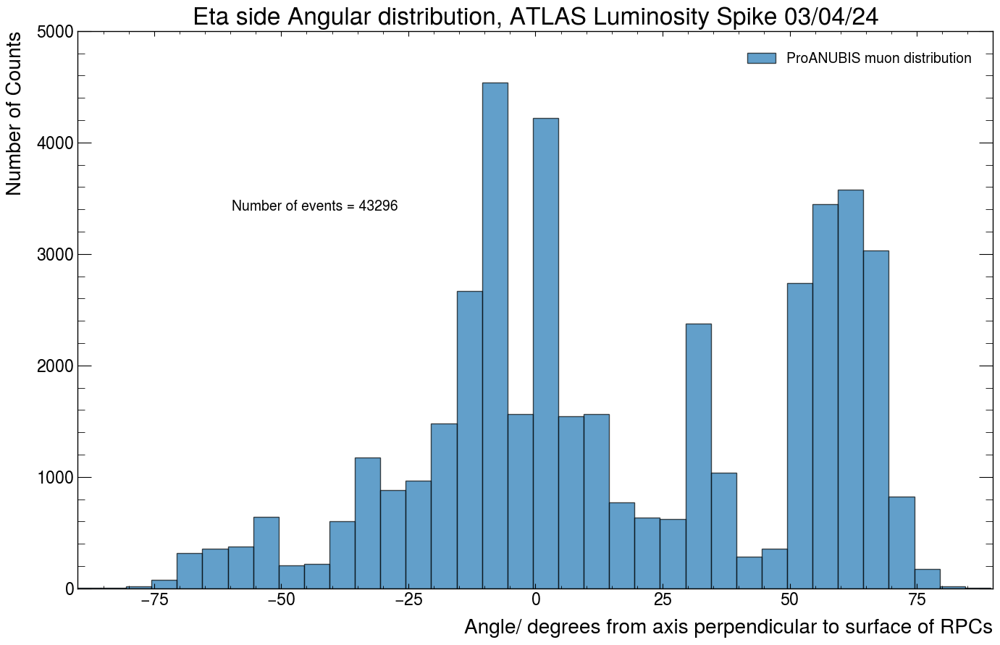

In [41]:
plot_angle_distribution_absolute(angles_eta2,"Eta side Angular distribution, ATLAS Luminosity Spike 03/04/24","ProANUBIS muon distribution")

Cosmics Data (same day)

In [42]:
Cosmics = ANT.importFromHDF5File(current_directory+"\\ProAnubisData\\ATLAS LUMINOSITY\\proAnubis_240403_1427_cosmics.h5")

data_cosmics = [sublist[:55489] for sublist in Cosmics]

c_etaHits, c_phiHits = ANT.divideHitCountsByRPC_Timed(data_cosmics)

#Time_window for coincidence set at 15 ns.
#Temporal Clustering
coincident_hits_cosmics = ANT.FindCoincidentHits(c_etaHits,c_phiHits,15)

#Spatial Clustering
coincident_hits_cosmics_clustered = ANT.cluster(coincident_hits_cosmics)

print(len(coincident_hits_cosmics_clustered))

0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1%
1

In [92]:
#Filter events depending on what you would like to look at.
#filter_events(data,minimum number of chambers hit, minimum number of RPCs hit)
cosmics_three_chamber_events = ANT.filter_events(coincident_hits_cosmics_clustered,1,3)
print("......")

Number of events in filter = 31150
......


In [99]:
angles_eta_cosmics, angles_phi_cosmics, times_delta_cosmics, z_delta_cosmics, chi2_values_cosmics = extract_angles_phi_eta_timed_DZ(cosmics_three_chamber_events)

Index= 0
Index= 1
Index= 2
Index= 3
Index= 4
Index= 5
Index= 6
Index= 7
Index= 8
Index= 9
Index= 10
Index= 11
Index= 12
Index= 13
Index= 14
Index= 15
Index= 16
Index= 17
Index= 18
Index= 19
Index= 20
Index= 21
Index= 22
Index= 23
Index= 24
Index= 25
Index= 26
Index= 27
Index= 28
Index= 29
Index= 30
Index= 31
Index= 32
Index= 33
Index= 34
Index= 35
Index= 36
Index= 37
Index= 38
Index= 39
Index= 40
Index= 41
Index= 42
Index= 43
Index= 44
Index= 45
Index= 46
Index= 47
Index= 48
Index= 49
Index= 50
Index= 51
Index= 52
Index= 53
Index= 54
Index= 55
Index= 56
Index= 57
Index= 58
Index= 59
Index= 60
Index= 61
Index= 62
Index= 63
Index= 64
Index= 65
Index= 66
Index= 67
Index= 68
Index= 69
Index= 70
Index= 71
Index= 72
Index= 73
Index= 74
Index= 75
Index= 76
Index= 77
Index= 78
Index= 79
Index= 80
Index= 81
Index= 82
Index= 83
Index= 84
Index= 85
Index= 86
Index= 87
Index= 88
Index= 89
Index= 90
Index= 91
Index= 92
Index= 93
Index= 94
Index= 95
Index= 96
Index= 97
Index= 98
Index= 99
Index= 100

C:\Users\patri\AppData\Local\Temp\ipykernel_21464\3774481439.py:138: RuntimeWarning:

divide by zero encountered in scalar divide

C:\Users\patri\AppData\Local\Temp\ipykernel_21464\3774481439.py:142: RuntimeWarning:

invalid value encountered in scalar multiply



Index= 3716
Index= 3717
Index= 3718
Index= 3719
Index= 3720
Index= 3721
Index= 3722
Index= 3723
Index= 3724
Index= 3725
Index= 3726
Index= 3727
Index= 3728
Index= 3729
Index= 3730
Index= 3731
Index= 3732
Index= 3733
Index= 3734
Index= 3735
Index= 3736
Index= 3737
Index= 3738
Index= 3739
Index= 3740
Index= 3741
Index= 3742
Index= 3743
Index= 3744
Index= 3745
Index= 3746
Index= 3747
Index= 3748
Index= 3749
Index= 3750
Index= 3751
Index= 3752
Index= 3753
Index= 3754
Index= 3755
Index= 3756
Index= 3757
Index= 3758
Index= 3759
Index= 3760
Index= 3761
Index= 3762
Index= 3763
Index= 3764
Index= 3765
Index= 3766
Index= 3767
Index= 3768
Index= 3769
Index= 3770
Index= 3771
Index= 3772
Index= 3773
Index= 3774
Index= 3775
Index= 3776
Index= 3777
Index= 3778
Index= 3779
Index= 3780
Index= 3781
Index= 3782
Index= 3783
Index= 3784
Index= 3785
Index= 3786
Index= 3787
Index= 3788
Index= 3789
Index= 3790
Index= 3791
Index= 3792
Index= 3793
Index= 3794
Index= 3795
Index= 3796
Index= 3797
Index= 3798
Inde

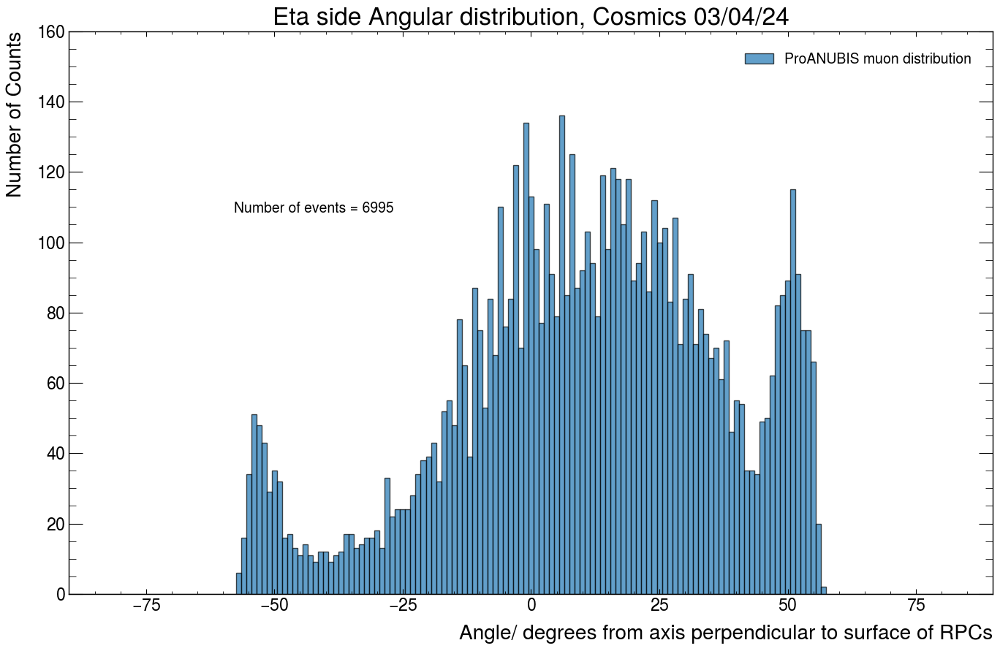

In [102]:
plot_angle_distribution_absolute(angles_eta_cosmics,"Eta side Angular distribution, Cosmics 03/04/24","ProANUBIS muon distribution",1)

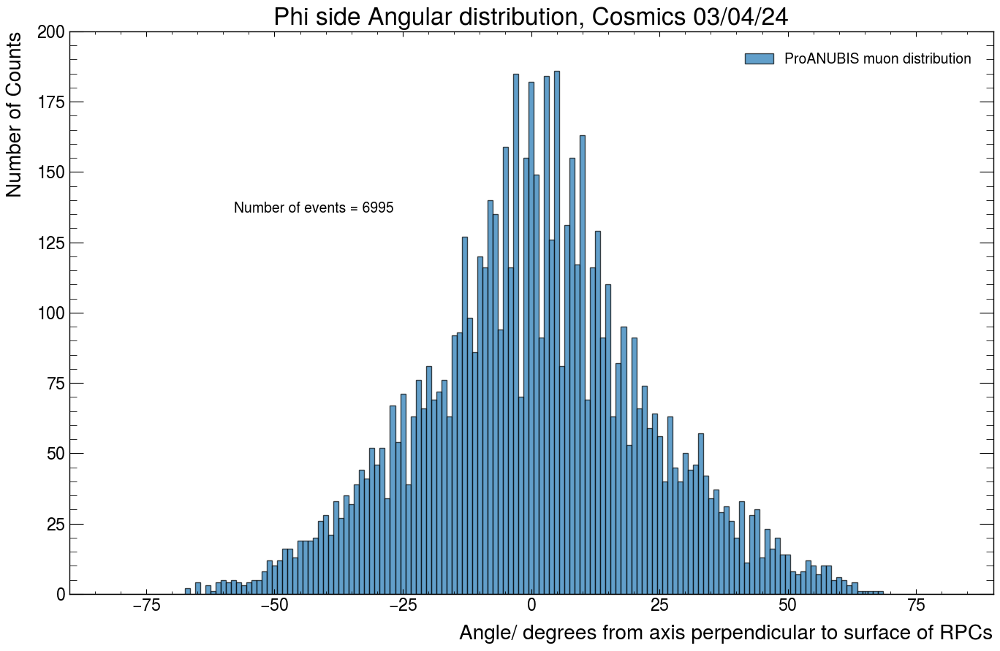

In [103]:
plot_angle_distribution_absolute(angles_phi_cosmics,"Phi side Angular distribution, Cosmics 03/04/24","ProANUBIS muon distribution",1)

In [106]:
angles_eta_degrees = [x*180/np.pi for x in angles_eta_cosmics]
# Create the 2D histogram with logarithm of counts
hist, x_edges, y_edges = np.histogram2d(angles_eta_degrees, times_delta_cosmics, bins=(81, 61))
hist_log = np.log10(hist + 1)  # Adding 1 to avoid taking log of zero

fig = go.Figure(go.Heatmap(
    z=hist_log.T,
    x=x_edges,
    y=y_edges,
    colorscale='Viridis',  # Choose a colourscale
    colorbar=dict(
        title='Log10 Counts'  # Label for colour bar
    ),
))

# Update layout to set axis ticks
fig.update_layout(
    xaxis=dict(
        title='Eta Angle/ °',  # Set x-axis title
        tickmode='linear',    # Set tick mode to linear
        tick0=0,              # Start tick at 0
        dtick=5,              # Set tick interval to 5 degrees
        range=[-60, 60],
        showgrid=True,        # Show gridlines
        gridcolor='lightgray',  # Set gridline colour
        gridwidth=1,          # Set gridline width
    ),
    yaxis=dict(
        title='dT / ns',      # Set y-axis title
        tickmode='linear',    # Set tick mode to linear
        tick0=0,              # Start tick at 0
        dtick=5,              # Set tick interval to 5 ns
        range=[-30, 30],
        showgrid=True,        # Show gridlines
        gridcolor='lightgray',  # Set gridline color
        gridwidth=1,          # Set gridline width
    ),
    width=1000,               # Set the width of the figure in pixels
    height=600,               # Set the height of the figure in pixels
    title='Variation of dT with eta angle, 2D histogram with Log of Counts, ATLAS Lumi Spike 03/04/24',
)

fig.show()


In [108]:
angles_phi_degrees = [x*180/np.pi for x in angles_phi_cosmics]
# Create the 2D histogram with logarithm of counts
hist, x_edges, y_edges = np.histogram2d(angles_phi_degrees, times_delta_cosmics, bins=(81, 61))
hist_log = np.log10(hist + 1)  # Adding 1 to avoid taking log of zero

fig = go.Figure(go.Heatmap(
    z=hist_log.T,
    x=x_edges,
    y=y_edges,
    colorscale='Viridis',  # Choose a colourscale
    colorbar=dict(
        title='Log10 Counts'  # Label for colour bar
    ),
))

# Update layout to set axis ticks
fig.update_layout(
    xaxis=dict(
        title='Phi Angle/ °',  # Set x-axis title
        tickmode='linear',    # Set tick mode to linear
        tick0=0,              # Start tick at 0
        dtick=5,              # Set tick interval to 5 degrees
        range=[-60, 60],
        showgrid=True,        # Show gridlines
        gridcolor='lightgray',  # Set gridline colour
        gridwidth=1,          # Set gridline width
    ),
    yaxis=dict(
        title='dT / ns',      # Set y-axis title
        tickmode='linear',    # Set tick mode to linear
        tick0=0,              # Start tick at 0
        dtick=5,              # Set tick interval to 5 ns
        range=[-30, 30],
        showgrid=True,        # Show gridlines
        gridcolor='lightgray',  # Set gridline color
        gridwidth=1,          # Set gridline width
    ),
    width=1000,               # Set the width of the figure in pixels
    height=600,               # Set the height of the figure in pixels
    title='Variation of dT with Phi angle, 2D histogram with Log of Counts, ATLAS Lumi Spike 03/04/24',
)

fig.show()


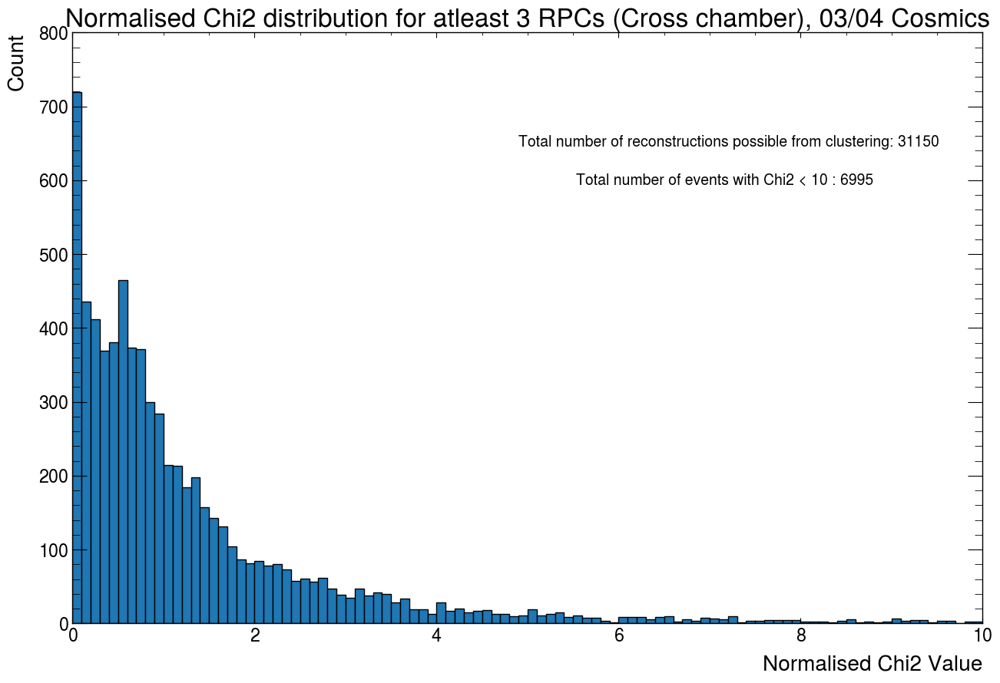

In [112]:
Chi2_values_filtered = [x for x in chi2_values_cosmics if x <= 10]

plt.figure(figsize=(15,10))

bin_edges = np.arange(-0.5, 11.5, 0.1)

plt.hist(Chi2_values_filtered,density=False,edgecolor='black',bins=bin_edges)

#plt.xlim(0,100)
#plt.yscale('log')

plt.xlabel('Normalised Chi2 Value')
plt.ylabel('Count')

plt.xlim(0,10)

plt.annotate(f"Total number of reconstructions possible from clustering: {len(cosmics_three_chamber_events)}",(0.45,0.7),xycoords='figure fraction')
plt.annotate(f"Total number of events with Chi2 < 10 : {len(Chi2_values_filtered)}",(0.5,0.65),xycoords='figure fraction')

plt.title('Normalised Chi2 distribution for atleast 3 RPCs (Cross chamber), 03/04 Cosmics')

plt.show()

In [117]:
def plot_angle_distribution_absolute_2(angles1, angles2, title, bin_size):
    # Flatten the arrays if they are multidimensional
    angles1 = np.asarray(angles1).flatten()
    angles2 = np.asarray(angles2).flatten()
    
    angles1_degrees = [x*(180/np.pi) for x in angles1]
    angles2_degrees = [x*(180/np.pi) for x in angles2]
    bin_edges = np.arange(-90.5, 91.5, bin_size)

    plt.figure(figsize=(16, 10))


    # Plot histogram with counts
    plt.hist(angles1_degrees, bins=bin_edges,density=False, edgecolor='black',label='ATLAS Luminosity spike')

    plt.hist(angles2_degrees, bins=bin_edges, density=False, edgecolor='black', alpha=0.5, color = 'green', label='Cosmics, 2 hours')


    # Customize the plot
    plt.xlabel('Angle/ degrees from axis perpendicular to surface of RPCs')
    plt.ylabel('Number of Counts')
    plt.title(title)
    plt.legend()
    plt.grid(False)
    plt.show()

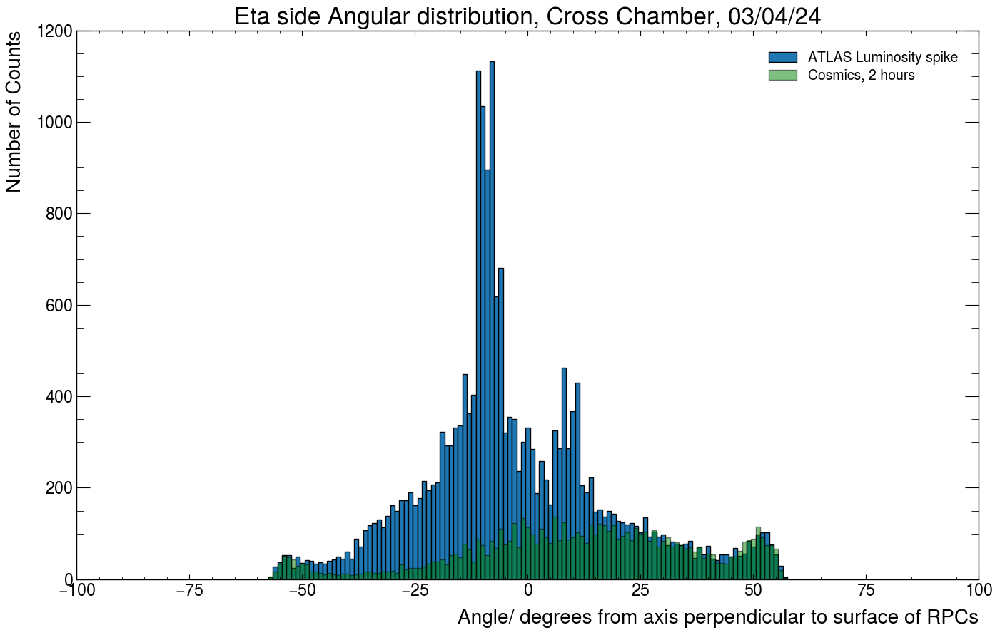

In [119]:
plot_angle_distribution_absolute_2(angles_eta,angles_eta_cosmics,"Eta side Angular distribution, Cross Chamber, 03/04/24",1)

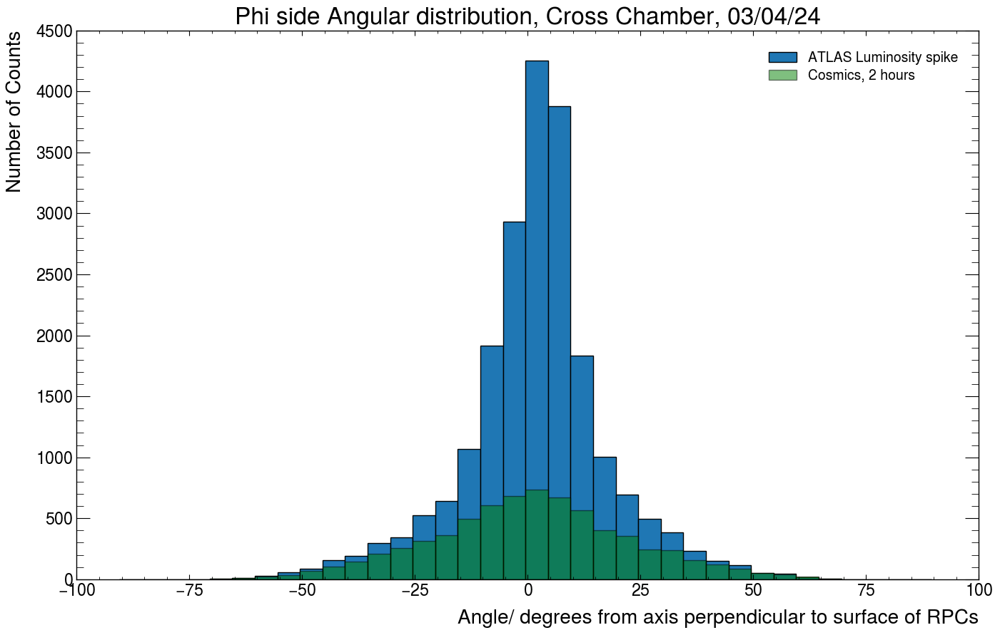

In [122]:
plot_angle_distribution_absolute_2(angles_phi,angles_phi_cosmics,"Phi side Angular distribution, Cross Chamber, 03/04/24",5)

Modifying code so they all point down for cosmics

In [6]:
def reconstruct_timed_Chi2_modified(event,max_cluster_size):

    #timed tag indicates that timing information from RPC is used to determine direction of vertical transversal of "particle" in the event.

    max_Chi2 = 10

    # event = ['Event x',TIMEBIN, [[[RPC1_PHI_CLUSTERS],[RPC1_ETA_CLUSTERS]],[[...],[...]],...]
    RPC_heights = [0.6,1.8,3.0,61.8,121.8,123] #Heights of middle point of each RPC, measured from the bottom of the Triplet Low RPC. Units are cm.

    #Extract x and y coords of cluster in event

    coords = ANT.extract_coords_timed_Chi2(event,max_cluster_size)

    # Count the number of empty RPCs
    empty_RPC_count = sum(1 for item in coords if item == [[], [],'N'])

    # If less than 3 elements of coords are occupied, exit the function
    if empty_RPC_count > 3:
        #print("Failed to reconstruct, not enough coords")
        return None  # Exit the function
    
    #NEED TO CHECK IF STILL CROSS CHAMBER! 

    cross_chamberness = 0

    if coords[0] != [[], [], 'N'] or coords[1] != [[], [], 'N'] or coords[2] != [[], [], 'N']:
        cross_chamberness += 1

    if coords[3] != [[], [], 'N']:
        cross_chamberness += 1

    if coords[4] != [[], [], 'N'] or coords[5] != [[], [], 'N']:
        cross_chamberness += 1

    # print(coords[0])
    # print(coords[1])
    # print(coords[2])
    # print(coords[3])
    # print(coords[4])
    # print(coords[5])
    # print(cross_chamberness)

    # if cross_chamberness < 2:
    #     #print("Failed to reconstruct, too few chambers")
    #     return None

    #ITERATING OVER EVERY POSSIBLE COMBINATION OF x,y,z over all 3 RPCs (limited to one x,y per RPC).
    #Doesn't look particularly nice, but there are not many coordinates to loop over usually....

    combinations = ANT.generate_hit_coords_combo_Chi2(coords,RPC_heights)

    #Now for each combo in combinations, attempt to reconstruct a path. See which one gives the best trajectory.

    #If success, print parameters of fitting function.
    #If fail, print reconstruction failed.

    Chi2_current = np.inf
    optimised_coords = None
    optimised_d= None
    optimised_centroid= None
    dT = np.inf

    for ind,combo in enumerate(combinations):

        centroid, d, Chi2, coordinates, delta_T, delta_Z= fit_event_chi2(combo)
        if Chi2 < Chi2_current:

            # If new fit is better than old then replace old fit properties.
            dZ = delta_Z 
            dT = delta_T
            Chi2_current = Chi2
            optimised_centroid = centroid
            optimised_d = d
            optimised_coords = coordinates

    #if dT>0 this implies the particles hit the higher RPC after the lower one, so the particle is travelling upwards here.
    #Vice-versa for dT < 0.

    #dT = 0 case?
    
    if dT != np.inf:
        
        if optimised_d[2] > 0:
            optimised_d = np.multiply(optimised_d,-1)

        if Chi2_current<max_Chi2:
            return optimised_centroid, optimised_d, optimised_coords, combinations, Chi2_current, dT, dZ

        else:
            #print("Failed to reconstruct, Chi2 too large")
            #return optimised_centroid, optimised_d, optimised_coords, combinations, residuals_current
            return None

In [7]:
def extract_angles_phi_eta_timed_DZ_modified(filtered_events):

    #Input is filtered_events, output of ANT.filter_events() function

    angles_eta = []
    angles_phi = []
    delta_times = []
    dZ = []
    chi2_values = []

    for i,filtered_event in enumerate(filtered_events):

        print(f"Index= {i}") 
        
        result = reconstruct_timed_Chi2_modified(filtered_event,3)

        if result is not None:

            delta_times.append(result[5])

            chi2_values.append(result[4])

            if abs(result[5])>40:
                print(f"Index of abnormal event= {i}")
            #Only save angles that actually were reconstructed well

            dZ.append(result[6])
            
            # a.b = |a||b|cos(x)

            #eta angle. 
            #work out the projection of the direction vector in the plane.
            
            v_parr_eta = np.array([0,result[1][1],result[1][2]])

            theta_eta = np.arccos(np.dot(v_parr_eta,[0,0,1]) / np.linalg.norm(v_parr_eta))

            if theta_eta > np.pi / 2:
                theta_eta= np.pi - theta_eta
            
            if v_parr_eta[1] > 0:
                theta_eta*=-1

            angles_eta.append(theta_eta)

            # Phi angles
            #work out the projection of the direction vector in the plane.
            
            v_parr_phi = np.array([result[1][0],0,result[1][2]])

            theta_phi = np.arccos(np.dot(v_parr_phi,[0,0,1]) / np.linalg.norm(v_parr_phi))

            if theta_phi > np.pi / 2:
                theta_phi= np.pi - theta_phi
            
            if v_parr_phi[0] < 0:
                theta_phi*=-1

            angles_phi.append(theta_phi)

    return angles_eta, angles_phi, delta_times, dZ, chi2_values

Index= 0
Index= 1
Index= 2
Index= 3
Index= 4
Index= 5
Index= 6
Index= 7
Index= 8
Index= 9
Index= 10
Index= 11
Index= 12
Index= 13
Index= 14
Index= 15
Index= 16
Index= 17
Index= 18
Index= 19
Index= 20
Index= 21
Index= 22
Index= 23
Index= 24
Index= 25
Index= 26
Index= 27
Index= 28
Index= 29
Index= 30
Index= 31
Index= 32
Index= 33
Index= 34
Index= 35
Index= 36
Index= 37
Index= 38
Index= 39
Index= 40
Index= 41
Index= 42
Index= 43
Index= 44
Index= 45
Index= 46
Index= 47
Index= 48
Index= 49
Index= 50
Index= 51
Index= 52
Index= 53
Index= 54
Index= 55
Index= 56
Index= 57
Index= 58
Index= 59
Index= 60
Index= 61
Index= 62
Index= 63
Index= 64
Index= 65
Index= 66
Index= 67
Index= 68
Index= 69
Index= 70
Index= 71
Index= 72
Index= 73
Index= 74
Index= 75
Index= 76
Index= 77
Index= 78
Index= 79
Index= 80
Index= 81
Index= 82
Index= 83
Index= 84
Index= 85
Index= 86
Index= 87
Index= 88
Index= 89
Index= 90
Index= 91
Index= 92
Index= 93
Index= 94
Index= 95
Index= 96
Index= 97
Index= 98
Index= 99
Index= 100

C:\Users\patri\AppData\Local\Temp\ipykernel_21464\3290246452.py:138: RuntimeWarning:

divide by zero encountered in scalar divide

C:\Users\patri\AppData\Local\Temp\ipykernel_21464\3290246452.py:143: RuntimeWarning:

invalid value encountered in scalar multiply

C:\Users\patri\AppData\Local\Temp\ipykernel_21464\3290246452.py:138: RuntimeWarning:

invalid value encountered in scalar divide



Index= 623
Index= 624
Index= 625
Index= 626
Index= 627
Index= 628
Index= 629
Index= 630
Index= 631
Index= 632
Index= 633
Index= 634
Index= 635
Index= 636
Index= 637
Index= 638
Index= 639
Index= 640
Index= 641
Index= 642
Index= 643
Index= 644
Index= 645
Index= 646
Index= 647
Index= 648
Index= 649
Index= 650
Index= 651
Index= 652
Index= 653
Index= 654
Index= 655
Index= 656
Index= 657
Index= 658
Index= 659
Index= 660
Index= 661
Index= 662
Index= 663
Index= 664
Index= 665
Index= 666
Index= 667
Index= 668
Index= 669
Index= 670
Index= 671
Index= 672
Index= 673
Index= 674
Index= 675
Index= 676
Index= 677
Index= 678
Index= 679
Index= 680
Index= 681
Index= 682
Index= 683
Index= 684
Index= 685
Index= 686
Index= 687
Index= 688
Index= 689
Index= 690
Index= 691
Index= 692
Index= 693
Index= 694
Index= 695
Index= 696
Index= 697
Index= 698
Index= 699
Index= 700
Index= 701
Index= 702
Index= 703
Index= 704
Index= 705
Index= 706
Index= 707
Index= 708
Index= 709
Index= 710
Index= 711
Index= 712
Index= 713

C:\Users\patri\AppData\Local\Temp\ipykernel_21464\3290246452.py:142: RuntimeWarning:

invalid value encountered in scalar multiply



Index= 3356
Index= 3357
Index= 3358
Index= 3359
Index= 3360
Index= 3361
Index= 3362
Index= 3363
Index= 3364
Index= 3365
Index= 3366
Index= 3367
Index= 3368
Index= 3369
Index= 3370
Index= 3371
Index= 3372
Index= 3373
Index= 3374
Index= 3375
Index= 3376
Index= 3377
Index= 3378
Index= 3379
Index= 3380
Index= 3381
Index= 3382
Index= 3383
Index= 3384
Index= 3385
Index= 3386
Index= 3387
Index= 3388
Index= 3389
Index= 3390
Index= 3391
Index= 3392
Index= 3393
Index= 3394
Index= 3395
Index= 3396
Index= 3397
Index= 3398
Index= 3399
Index= 3400
Index= 3401
Index= 3402
Index= 3403
Index= 3404
Index= 3405
Index= 3406
Index= 3407
Index= 3408
Index= 3409
Index= 3410
Index= 3411
Index= 3412
Index= 3413
Index= 3414
Index= 3415
Index= 3416
Index= 3417
Index= 3418
Index= 3419
Index= 3420
Index= 3421
Index= 3422
Index= 3423
Index= 3424
Index= 3425
Index= 3426
Index= 3427
Index= 3428
Index= 3429
Index= 3430
Index= 3431
Index= 3432
Index= 3433
Index= 3434
Index= 3435
Index= 3436
Index= 3437
Index= 3438
Inde

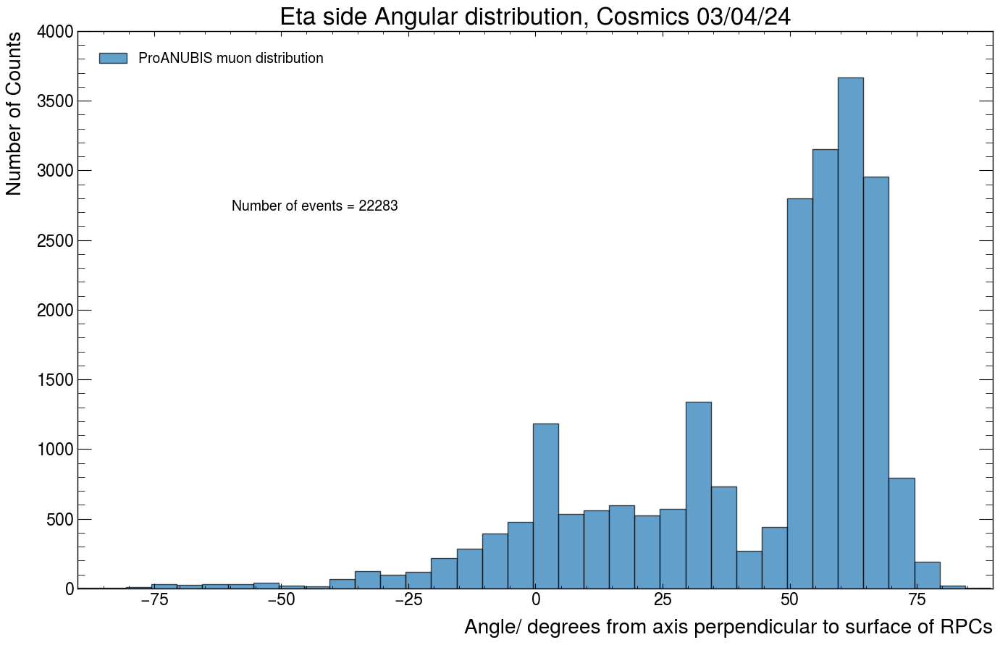

In [67]:
angles_eta_cosmics, angles_phi_cosmics, times_delta_cosmics, z_delta_cosmics, chi2_values_cosmics = extract_angles_phi_eta_timed_DZ_modified(cosmics_three_chamber_events)


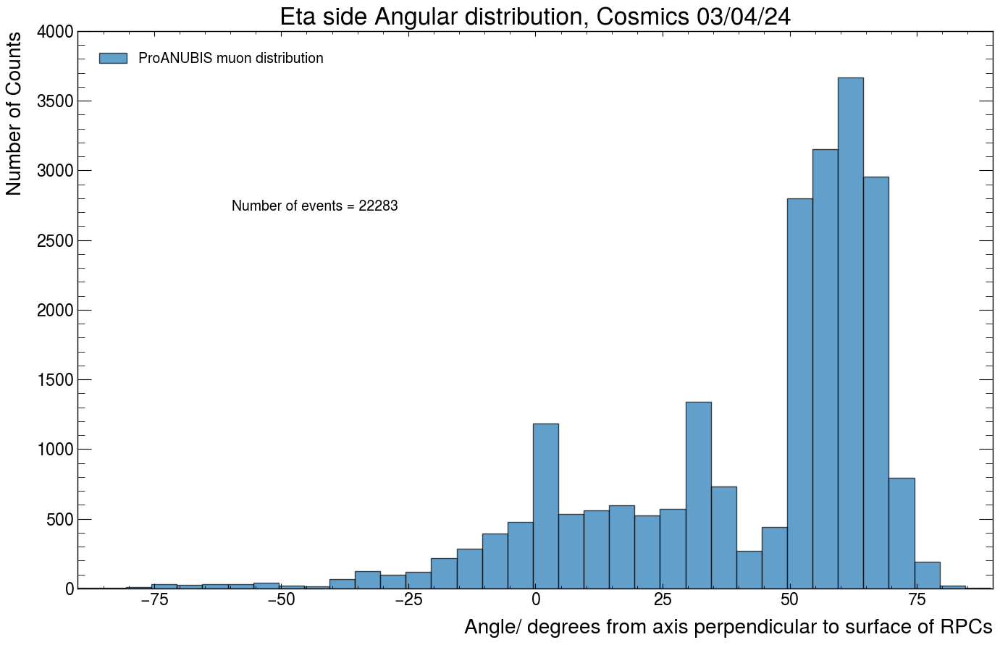

In [73]:
plot_angle_distribution_absolute(angles_eta_cosmics,"Eta side Angular distribution, Cosmics 03/04/24","ProANUBIS muon distribution",5)

Cosmics From over a month ago,

Doublet had higher efficiency then 03/04 !

In [8]:
data = ANT.importDatafile(current_directory+"\\ProAnubisData\\threeHourRun_24_3_1.h5")

etaHits, phiHits = ANT.divideHitCountsByRPC_Timed(data)

#ANT.importDatafile is from original scripts. ANT.divideHitCountsByRPC_Timed() is modified from original scripts. All other functions are new.

#Time_window for coincidence set at 15 ns.
#Temporal Clustering
coincident_hits_3HRS = ANT.FindCoincidentHits(etaHits,phiHits,15)

#Spatial Clustering
coincident_hits_3HRS_clustered = ANT.cluster(coincident_hits_3HRS)

0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0%
0

In [9]:
#Filter events depending on what you would like to look at.
#filter_events(data,minimum number of chambers hit, minimum number of RPCs hit)
cosmics_old_three_chamber_events = ANT.filter_events(coincident_hits_3HRS_clustered,1,3)
print("......")

Number of events in filter = 65434
......


In [10]:
def extract_angles_phi_eta_timed_DZ_modified(filtered_events):

    #Input is filtered_events, output of ANT.filter_events() function

    angles_eta = []
    angles_phi = []
    delta_times = []
    dZ = []
    chi2_values = []

    for i,filtered_event in enumerate(filtered_events):
        
        result = reconstruct_timed_Chi2_modified(filtered_event,3)

        if result is not None:

            delta_times.append(result[5])

            chi2_values.append(result[4])

            if abs(result[5])>40:
                print(f"Index of abnormal event= {i}")
            #Only save angles that actually were reconstructed well

            dZ.append(result[6])
            
            # a.b = |a||b|cos(x)

            #eta angle. 
            #work out the projection of the direction vector in the plane.
            
            v_parr_eta = np.array([0,result[1][1],result[1][2]])

            theta_eta = np.arccos(np.dot(v_parr_eta,[0,0,1]) / np.linalg.norm(v_parr_eta))

            if theta_eta > np.pi / 2:
                theta_eta= np.pi - theta_eta
            
            if v_parr_eta[1] > 0:
                theta_eta*=-1

            angles_eta.append(theta_eta)

            # Phi angles
            #work out the projection of the direction vector in the plane.
            
            v_parr_phi = np.array([result[1][0],0,result[1][2]])

            theta_phi = np.arccos(np.dot(v_parr_phi,[0,0,1]) / np.linalg.norm(v_parr_phi))

            if theta_phi > np.pi / 2:
                theta_phi= np.pi - theta_phi
            
            if v_parr_phi[0] < 0:
                theta_phi*=-1

            if theta_eta > np.pi/3:
                print(f"Index {i}")
                
            angles_phi.append(theta_phi)

    return angles_eta, angles_phi, delta_times, dZ, chi2_values

In [11]:
angles_eta_cosmics, angles_phi_cosmics, times_delta_cosmics, z_delta_cosmics, chi2_values_cosmics = extract_angles_phi_eta_timed_DZ_modified(cosmics_old_three_chamber_events)

Index 9
Index 27
Index 28
Index 29
Index 31
Index 46
Index 47
Index 52
Index 53
Index 65
Index 68
Index 83
Index 85
Index 86
Index 98
Index 99
Index 124
Index 134
Index 135
Index 137
Index 140
Index 147
Index 148
Index 152
Index 158
Index 164
Index 173
Index 183
Index 191
Index 194
Index 211
Index 223
Index 231
Index 234
Index 244
Index 249
Index 259
Index 269
Index 270
Index 280
Index 281
Index 285
Index 288
Index 291
Index 295
Index 303
Index 322
Index 326
Index 327
Index 330
Index 349
Index 370
Index 378
Index 385
Index 388
Index 390
Index 403
Index 411
Index 416
Index 418
Index 420
Index 421
Index 423
Index 429
Index 450
Index 468
Index 469
Index 470
Index 489
Index 499
Index 503
Index 506
Index 511
Index 514
Index 516
Index 523
Index 533
Index 538
Index 550
Index 552
Index 557
Index 574
Index 576


C:\Users\patri\AppData\Local\Temp\ipykernel_4604\3774481439.py:138: RuntimeWarning: divide by zero encountered in scalar divide
  t = (z-z_0)/d[2]
C:\Users\patri\AppData\Local\Temp\ipykernel_4604\3774481439.py:143: RuntimeWarning: invalid value encountered in scalar multiply
  y_traj = centroid[1] + t*d[1]
C:\Users\patri\AppData\Local\Temp\ipykernel_4604\3774481439.py:138: RuntimeWarning: invalid value encountered in scalar divide
  t = (z-z_0)/d[2]


Index 593
Index 619
Index 648
Index 656
Index 659
Index 675
Index 683
Index 694
Index 705
Index 708
Index 716
Index 725
Index 728
Index 739
Index 760
Index 771
Index 772
Index 773
Index 778
Index 786
Index 806
Index 809
Index 813
Index 815
Index 817
Index 827
Index 853
Index 857
Index of abnormal event= 863
Index 871
Index 884
Index 887
Index 893
Index 894
Index 906
Index 907
Index 908
Index 913
Index 927
Index 936
Index 940
Index 953
Index 956
Index 957
Index 958
Index 964
Index 966
Index 982
Index 984
Index 986
Index 989
Index 995
Index 1005
Index 1009
Index 1023
Index 1033
Index 1040
Index 1059
Index 1067
Index 1075
Index 1089
Index 1100
Index 1120
Index 1122
Index 1153
Index 1163
Index 1170
Index 1171
Index 1175
Index 1183
Index 1209
Index 1211
Index 1221
Index 1229
Index 1233
Index 1246
Index 1272
Index 1274
Index 1275
Index 1282
Index 1294
Index 1298
Index 1301
Index 1312
Index 1316
Index 1326
Index 1330
Index 1331
Index 1338
Index 1343
Index 1349
Index 1350
Index 1354
Index 1362

C:\Users\patri\AppData\Local\Temp\ipykernel_4604\3774481439.py:142: RuntimeWarning: invalid value encountered in scalar multiply
  x_traj = centroid[0] + t*d[0]


Index 5218
Index 5233
Index 5239
Index 5245
Index 5276
Index 5279
Index 5281
Index 5285
Index 5294
Index 5302
Index 5317
Index 5330
Index 5339
Index 5350
Index 5358
Index 5376
Index 5392
Index 5400
Index 5405
Index 5411
Index 5443
Index 5454
Index 5459
Index 5466
Index 5475
Index 5477
Index 5479
Index 5483
Index 5486
Index 5495
Index 5508
Index 5514
Index 5519
Index 5527
Index 5531
Index 5534
Index 5545
Index 5548
Index 5549
Index 5551
Index 5552
Index 5553
Index 5555
Index 5558
Index 5559
Index 5567
Index 5570
Index 5585
Index 5592
Index 5596
Index 5600
Index 5605
Index 5609
Index 5611
Index 5614
Index 5615
Index 5622
Index 5625
Index 5644
Index 5648
Index 5651
Index 5658
Index 5699
Index 5701
Index 5707
Index 5734
Index 5763
Index 5774
Index 5780
Index 5784
Index 5791
Index 5792
Index 5810
Index 5816
Index 5843
Index 5853
Index 5858
Index 5876
Index 5900
Index 5910
Index 5918
Index 5919
Index 5944
Index 5951
Index 5955
Index 5960
Index 5964
Index 5968
Index 5970
Index 5976
Index 5984

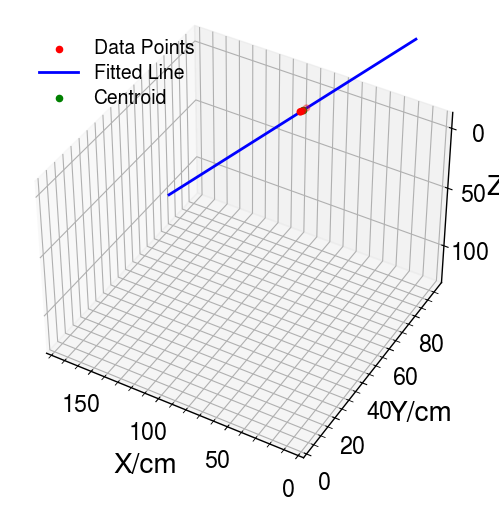

In [51]:
E17_223 = ANT.reconstruct(cosmics_old_three_chamber_events[989],3)

ANT.non_interactive_muon_plot(E17_223[0],E17_223[1],E17_223[2])

In [52]:
ANT.interactive_muon_plot(E17_223[0],E17_223[1],E17_223[2])

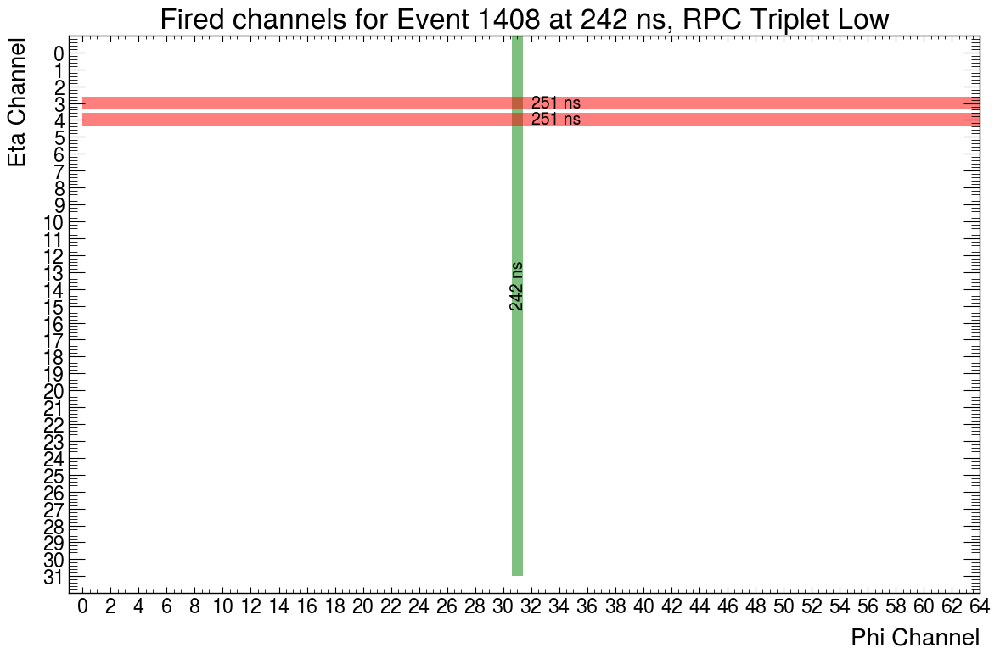

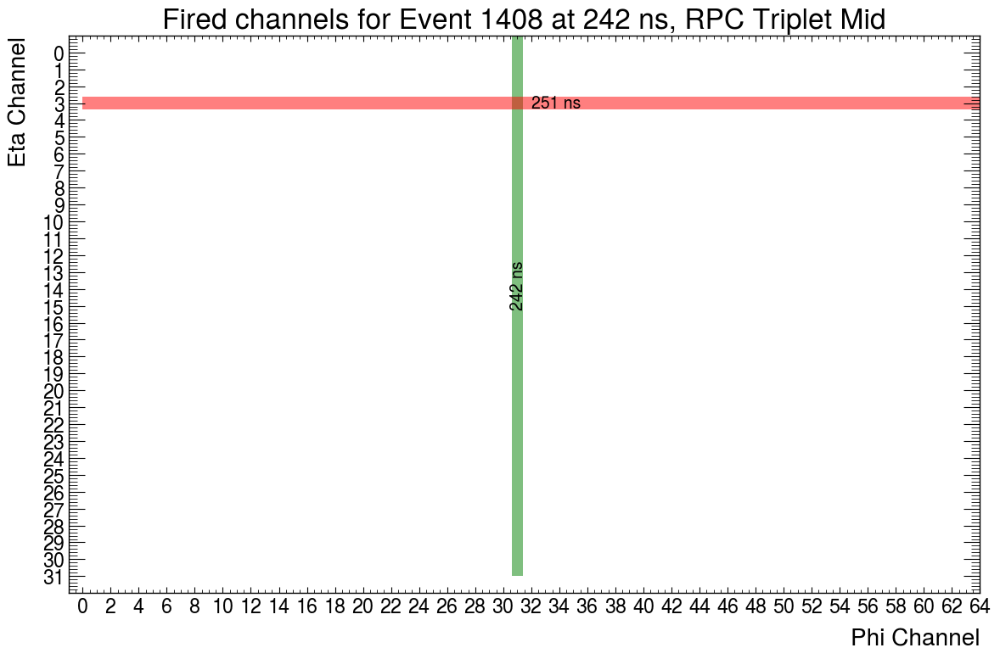

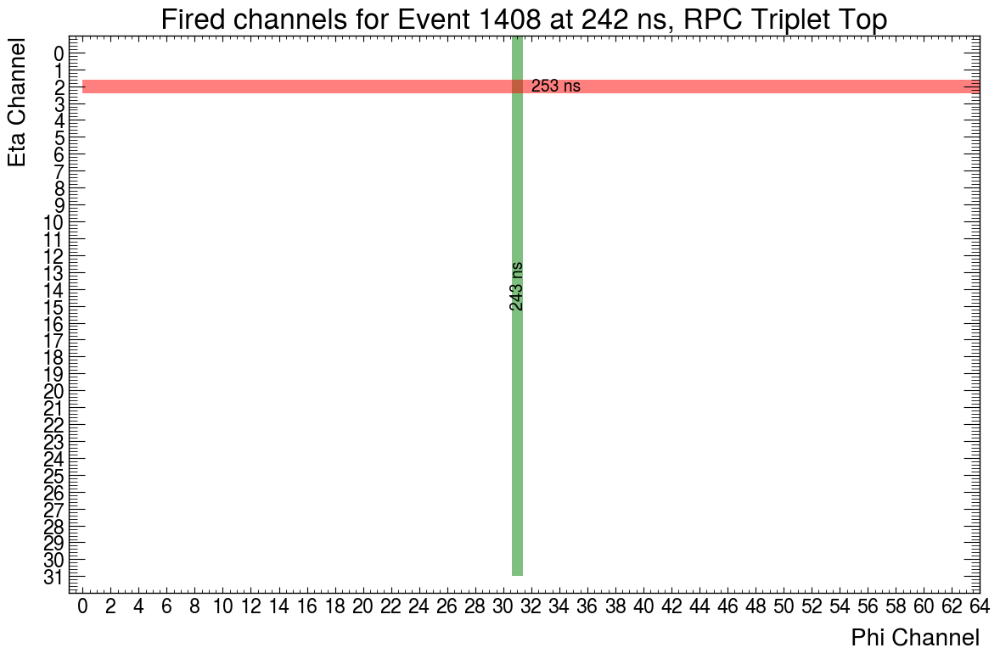

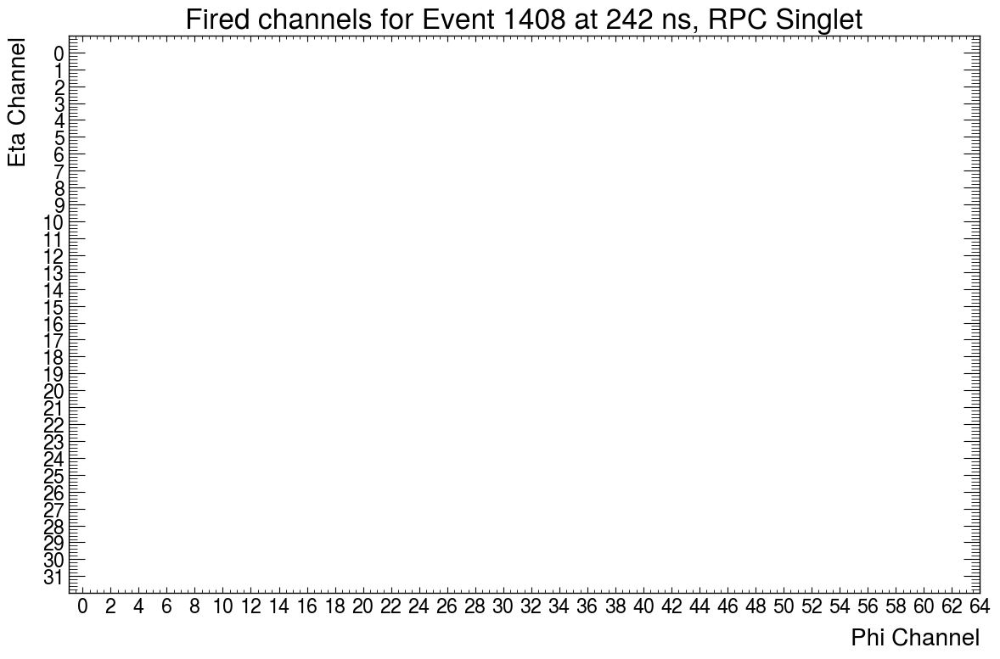

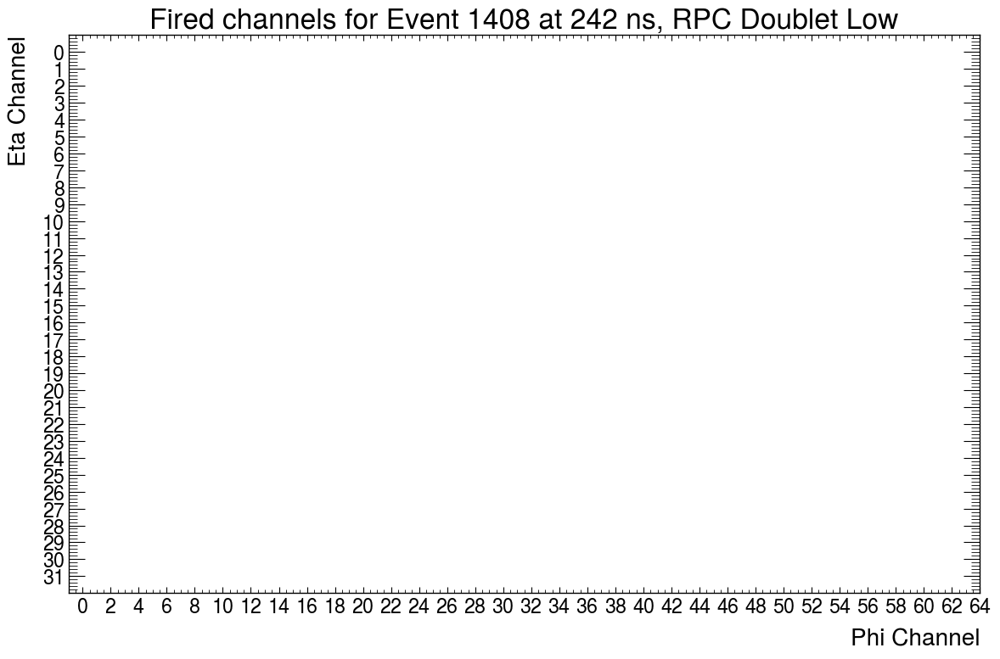

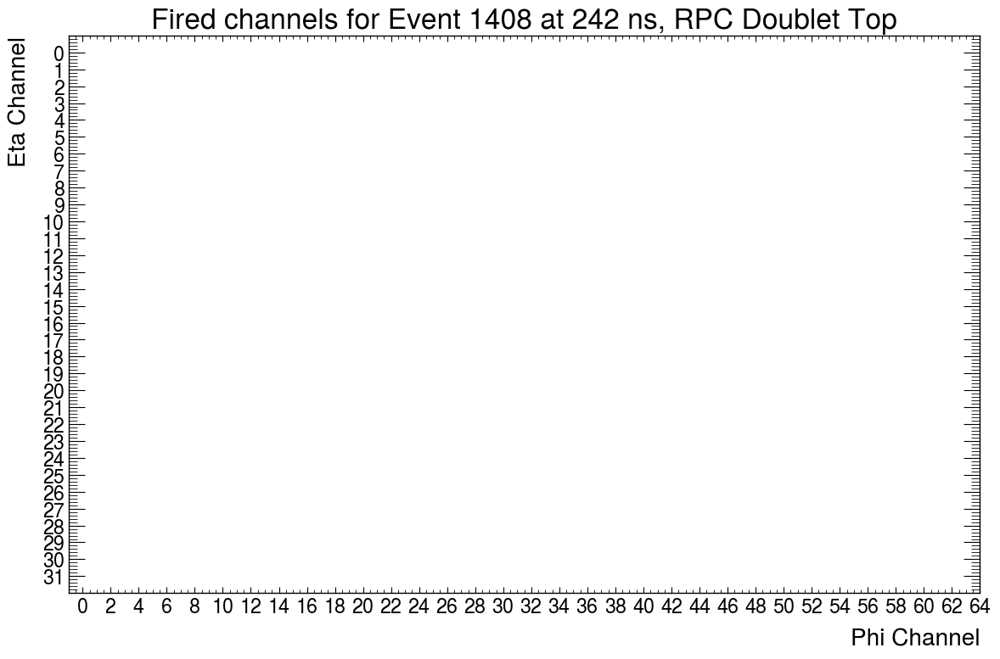

In [53]:
ANT.plot_event_cluster(ANT.convert_cluster_to_plot(cosmics_old_three_chamber_events[989]))

In [64]:
def plot_angle_distribution_absolute(angles, title, label, bin_size):
    #Plot angular distribution given phi and eta angular distribution separately.
    #Plot absolute number of counts rather than relative occurence.
    #bin_size in degrees

    plt.figure(figsize=(16,10))

    angles_degrees = [x*(180/np.pi) for x in angles]
    bin_edges = np.arange(-90.5, 91.5, bin_size)

    # Plot histogram with counts
    plt.hist(angles_degrees, bins=bin_edges, density=False,edgecolor='black',alpha=0.7, label=f"{label}")
    
    plt.annotate(f"Number of events = {len(angles)}",(0.2,0.6),xycoords='figure fraction')

    plt.xlim(-90,90)
    plt.ylim(0,3500)

    # Customize the plot
    plt.xlabel('Angle from proANUBIS XZ plane / degrees')
    plt.ylabel('Number of Counts')
    plt.title(title)
    plt.legend()
    plt.show()

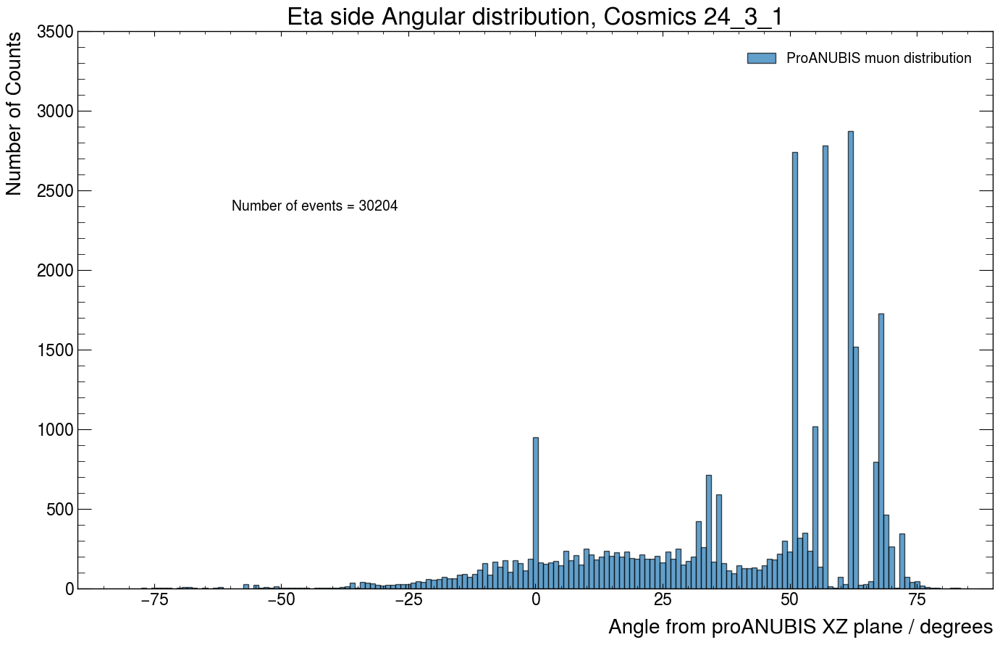

In [65]:
plot_angle_distribution_absolute(angles_eta_cosmics,"Eta side Angular distribution, Cosmics 24_3_1","ProANUBIS muon distribution",1)

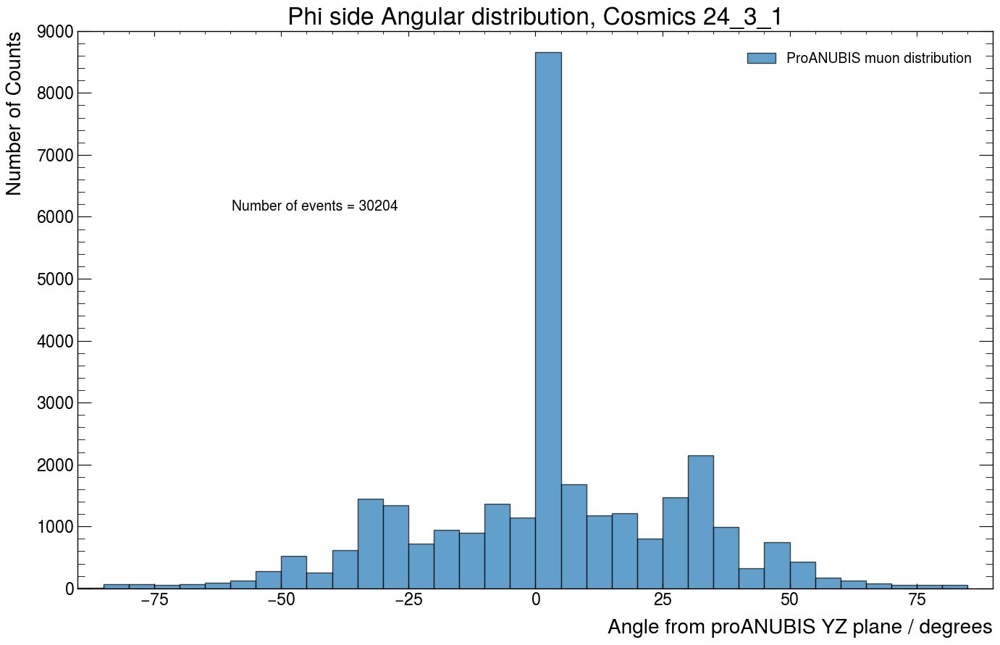

In [50]:
plot_angle_distribution_absolute(angles_phi_cosmics,"Phi side Angular distribution, Cosmics 24_3_1","ProANUBIS muon distribution",5)

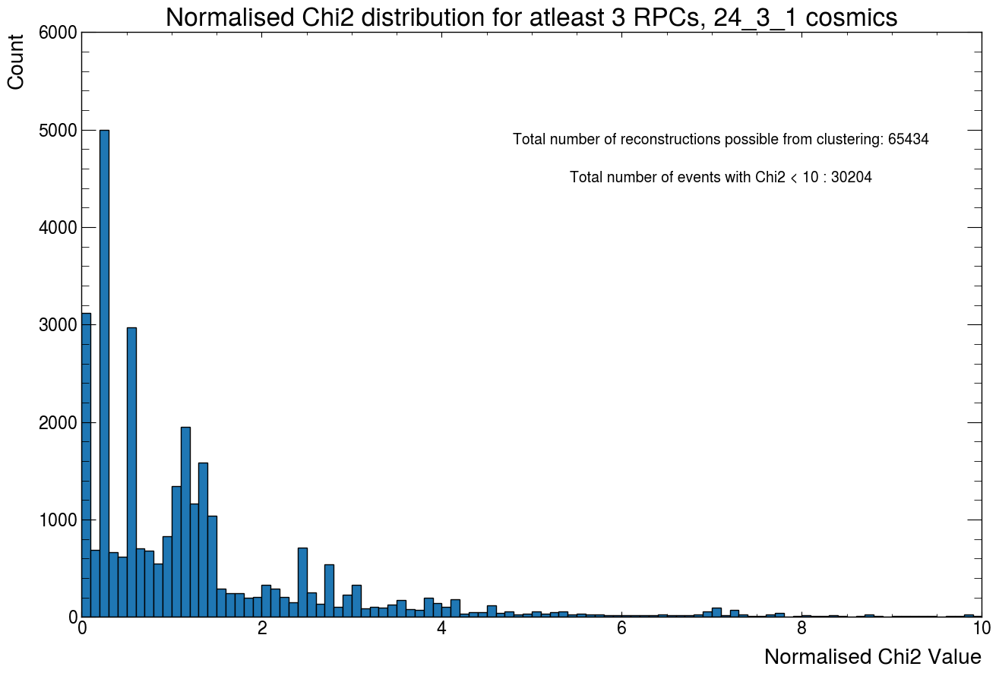

In [58]:
Chi2_values_filtered = [x for x in chi2_values_cosmics if x <= 10]

plt.figure(figsize=(15,10))

bin_edges = np.arange(-0.5, 11.5, 0.1)

plt.hist(Chi2_values_filtered,density=False,edgecolor='black',bins=bin_edges)

#plt.xlim(0,100)
#plt.yscale('log')

plt.xlabel('Normalised Chi2 Value')
plt.ylabel('Count')

plt.xlim(0,10)

plt.annotate(f"Total number of reconstructions possible from clustering: {len(cosmics_old_three_chamber_events)}",(0.45,0.7),xycoords='figure fraction')
plt.annotate(f"Total number of events with Chi2 < 10 : {len(Chi2_values_filtered)}",(0.5,0.65),xycoords='figure fraction')

plt.title('Normalised Chi2 distribution for atleast 3 RPCs, 24_3_1 cosmics')

plt.show()

In [59]:
#Filter events depending on what you would like to look at.
#filter_events(data,minimum number of chambers hit, minimum number of RPCs hit)
cosmics_old_cross_chamber = ANT.filter_events(coincident_hits_3HRS_clustered,2,3)
print("......")

Number of events in filter = 20183
......


In [60]:
angles_eta_cosmics, angles_phi_cosmics, times_delta_cosmics, z_delta_cosmics, chi2_values_cosmics = extract_angles_phi_eta_timed_DZ_modified(cosmics_old_cross_chamber)

Index 77
Index of abnormal event= 254
Index 258
Index 897
Index 1477
Index 1585
Index 1743


C:\Users\patri\AppData\Local\Temp\ipykernel_12632\3774481439.py:138: RuntimeWarning:

divide by zero encountered in scalar divide

C:\Users\patri\AppData\Local\Temp\ipykernel_12632\3774481439.py:138: RuntimeWarning:

invalid value encountered in scalar divide

C:\Users\patri\AppData\Local\Temp\ipykernel_12632\3774481439.py:143: RuntimeWarning:

invalid value encountered in scalar multiply



Index 2195
Index 2622
Index 3450
Index 3600
Index 5389
Index 5440
Index 6840
Index 7044
Index 7421
Index 8061
Index 8455
Index 9001
Index 9381
Index 9944
Index 10223
Index 10836
Index 11307
Index 11667
Index 11917
Index 12862
Index 12986
Index 13096
Index 13402
Index 13551
Index 14293
Index 14768
Index 15554
Index 16301
Index of abnormal event= 16793
Index of abnormal event= 16840
Index of abnormal event= 16967
Index 17665
Index 17944
Index 18213
Index 19560
Index 19690
Index 19774
Index 19912
Index 19943


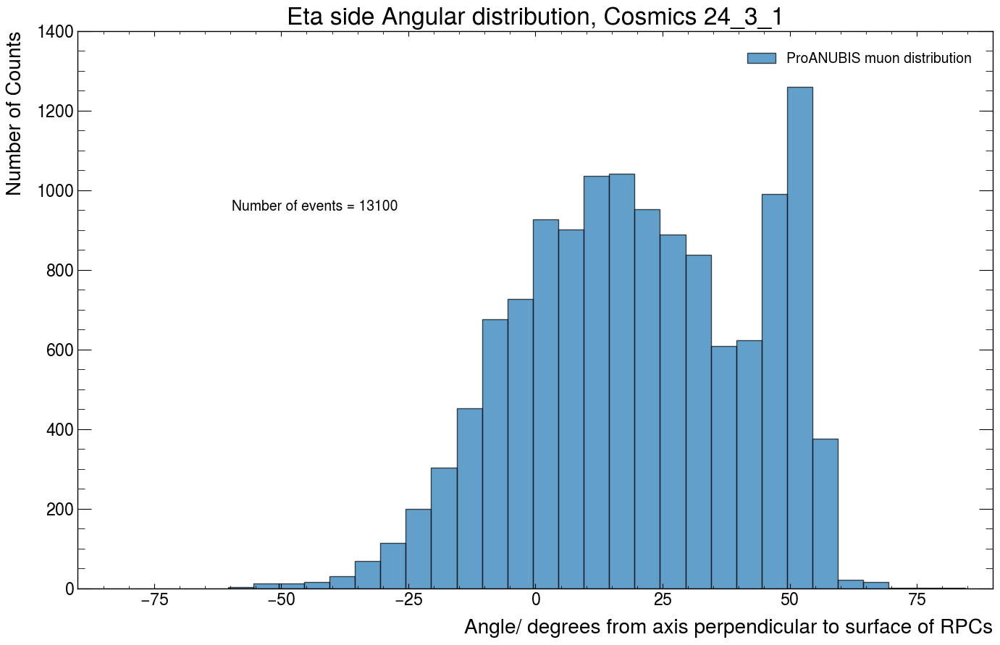

In [62]:
plot_angle_distribution_absolute(angles_eta_cosmics,"Eta side Angular distribution, Cosmics 24_3_1","ProANUBIS muon distribution",5)

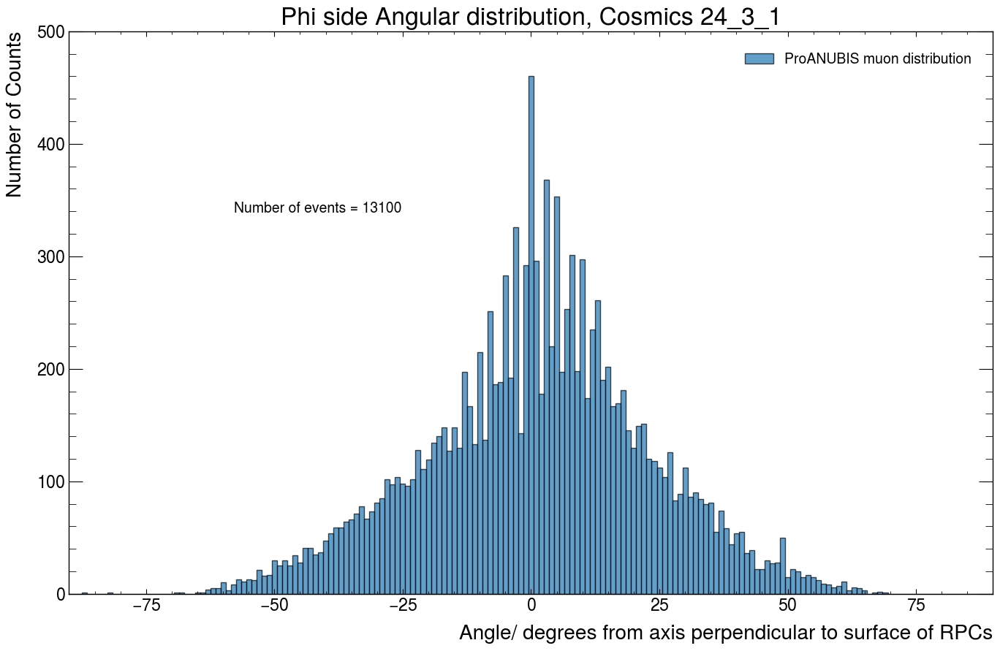

In [65]:
plot_angle_distribution_absolute(angles_phi_cosmics,"Phi side Angular distribution, Cosmics 24_3_1","ProANUBIS muon distribution",1)

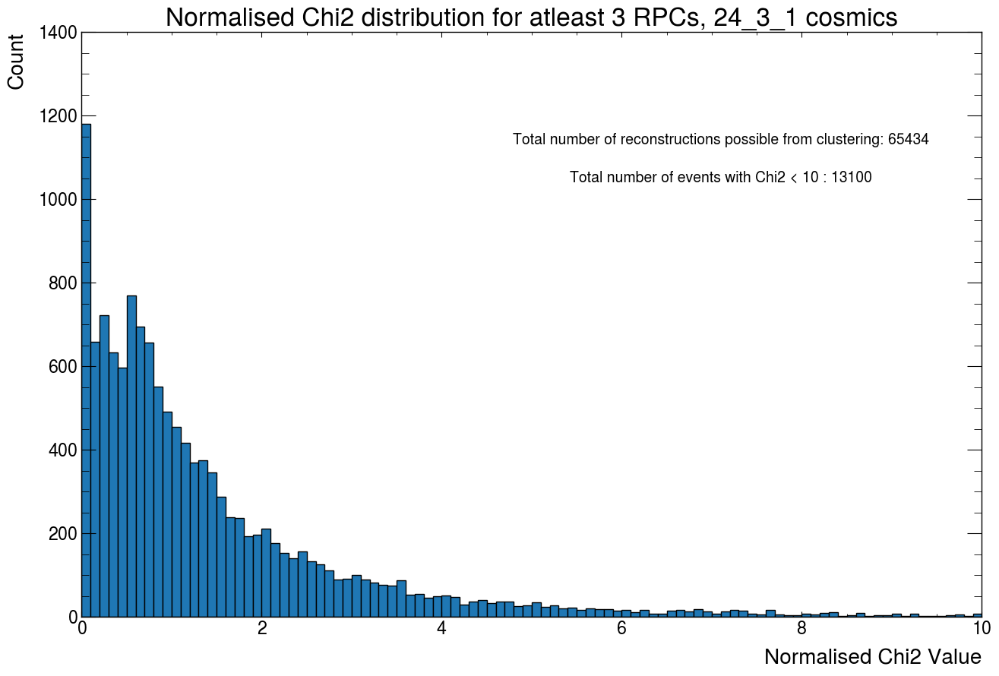

In [63]:
Chi2_values_filtered = [x for x in chi2_values_cosmics if x <= 10]

plt.figure(figsize=(15,10))

bin_edges = np.arange(-0.5, 11.5, 0.1)

plt.hist(Chi2_values_filtered,density=False,edgecolor='black',bins=bin_edges)

#plt.xlim(0,100)
#plt.yscale('log')

plt.xlabel('Normalised Chi2 Value')
plt.ylabel('Count')

plt.xlim(0,10)

plt.annotate(f"Total number of reconstructions possible from clustering: {len(cosmics_old_three_chamber_events)}",(0.45,0.7),xycoords='figure fraction')
plt.annotate(f"Total number of events with Chi2 < 10 : {len(Chi2_values_filtered)}",(0.5,0.65),xycoords='figure fraction')

plt.title('Normalised Chi2 distribution for atleast 3 RPCs, 24_3_1 cosmics')

plt.show()